In [1]:
import datetime as dt
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import APSIMGraphHelpers as AGH
import GraphHelpers as GH
from scipy import stats
import statsmodels.api as sm
from statsmodels.formula.api import ols
import matplotlib.dates as mdates
import MathsUtilities as MUte
import shlex # package to construct the git command to subprocess format
import subprocess 
import xmltodict, json
import sqlite3
from scipy.optimize import basinhopping
from scipy.optimize import dual_annealing
from skopt import gp_minimize
%matplotlib inline

In [2]:
Colors = {1:'#000000',
2:'#E69F00',
3:'#56B4E9',
4:'#009E73',
5:'#F0E442',
6:'#0072B2',
7:'#D55E00',
8:'#CC79A7',
9:'#1F77B4',
10:'#AEC7E8',
11:'#FF7F0E',
12:'#FFBB78',
13:'#2CA02C',
14:'#98DF8A',
15:'#D62728',
16:'#FF9896',
17:'#9467BD',
18:'#C5B0D5',
19:'#8C564B',
20:'#C49C94',
21:'#E377C2',
22:'#F7B6D2',
23:'#7F7F7F',
24:'#C7C7C7',
25:'#BCBD22',
26:'#DBDB8D',
27:'#17BECF',
28:'#9EDAE5'}

Markers = {1: 'o',
 2: '^',
 3: 's',
 4: '*',
 5: '>',
 6: 'v',
 7: '+',
 8: 'X',
 9: '<',
 10: 'p',
 11: '8',
 12: 'd',
 13:'P',
 14:'D',
 15:'o',
 16:'^'}

Lines = {1: '-',
 2: '--',
 3: '-,',
 4: ':',
 5: '-',
 6: '--',
 7: '-,',
 8: ':',
 9: '-',
 10: '--',
 11: '-,',
 12: ':',
 13: '-',
 14: '--',
 15: '-,',
 16: ':'}

In [3]:
MasterfilePath = r'C:\GitHubRepos\ApsimX\Tests\Validation\Wheat\Wheat.db'
DevfilePath = r'C:\GitHubRepos\ApsimX\Prototypes\WheatSimpleLeaf\WheatSL.db'
VariableRenamesFile = 'C:\GitHubRepos\ApsimX\Prototypes\WheatSimpleLeaf\SimpleLeafImplementation\VariableRenames.xlsx'
VRsheetname =  'SimpleLeafRenames'
VariableRenames = pd.read_excel(VariableRenamesFile,index_col=0, sheet_name='SimpleLeafRenames').to_dict()['SimpleLeaf']

In [4]:
SensibilityFolders = ['CO2AndTranspirationEfficiency',
'CO2AndTemperatureInteractions',
'ProteinAccumulation',
'LeafAppearance',
'TerminalWaterStress',
'DetailedDynamics']

In [5]:
#Set up simulations index table
def setSimulations(filePath):
    con = sqlite3.connect(filePath)
    Simulations = pd.read_sql("Select * from _Simulations",con)
    con.close()
    Simulations.set_index('ID',inplace=True)
    Simulations.sort_index(inplace=True)
    Simulations.sort_index(inplace=True, axis=1)
    
    return Simulations

MasterSimulations = setSimulations(MasterfilePath)
DevSimulations = setSimulations(DevfilePath)

In [6]:
# read in predicted values output on harvest date
def setHarvestPred(filePath,Simulations):
    con = sqlite3.connect(filePath)
    HarvestPred = pd.read_sql("Select * from HarvestReport",con).dropna(axis=1,how='all')
    con.close()
    HarvestPred.loc[:,'SimulationName'] = [Simulations.loc[x,'Name'] for x in HarvestPred.SimulationID]
    HarvestPred.set_index(['SimulationName','Clock.Today'],drop=False,inplace=True)
    HarvestPred.sort_index(inplace=True)
    HarvestPred.sort_index(inplace=True,axis=1)
    
    # Filter outputs from sensibility tests
    validationFilter = [x not in SensibilityFolders for x in HarvestPred.FolderName]
    HarvestPred = HarvestPred.loc[validationFilter,:].copy()
    HarvestPred.dropna(how='all',axis=1,inplace=True)
    HarvestPred.loc[:,'Wheat.SowingData.Cultivar'] = [x.title() for x in HarvestPred.loc[:,'Wheat.SowingData.Cultivar']]
    validationFilter = [x not in SensibilityFolders for x in HarvestPred.FolderName]
    HarvestPred = HarvestPred.loc[validationFilter,:].copy()
    HarvestPred.dropna(how='all',axis=1,inplace=True)

    # Replace Experiment with values that have had folder name pathed in where no experiment is present
    HarvestPred.loc[[x is None for x in HarvestPred.Experiment],'Experiment'] = HarvestPred.loc[[x is None for x in HarvestPred.Experiment],'FolderName']
    return HarvestPred

MasterHarvestPred = setHarvestPred(MasterfilePath, MasterSimulations)
DevHarvestPred = setHarvestPred(DevfilePath, DevSimulations)

In [7]:
#Set up additional index table
def makeLists(HarvestPred):
    Latitudes = list(HarvestPred.loc[:,'IWeather.Latitude'].drop_duplicates().values)
    Latitudes.sort()
    Longitudes = list(HarvestPred.loc[:,'IWeather.Longitude'].drop_duplicates().values)
    Longitudes.sort()
    Countries = list(HarvestPred.loc[:,'LocationInfo.Script.Country'].drop_duplicates().values)
    Regions = list(HarvestPred.loc[:, 'LocationInfo.Script.Region'].drop_duplicates().values)
    States = list(HarvestPred.loc[:,'LocationInfo.Script.State'].drop_duplicates().values)
    Cultivars = list(HarvestPred.loc[:,'Wheat.SowingData.Cultivar'].drop_duplicates().values)
    Cultivars.sort()
    Experiments = list(HarvestPred.loc[:,'Experiment'].drop_duplicates().values)
    Folders = list(HarvestPred.loc[:,'FolderName'].drop_duplicates().values)
    return Latitudes, Longitudes, Countries, Regions, States, Cultivars, Experiments, Folders

Masterlatitudes, MasterLongitudes, MasterCountries, MasterRegions, MasterStages, MasterCultivars, MasterExperiments, MasterFolders = makeLists(MasterHarvestPred)
Devlatitudes, DevLongitudes, DevCountries, DevRegions, DevStages, DevCultivars, DevExperiments, DevFolders = makeLists(DevHarvestPred)

In [8]:
SowIndices = ['IWeather.Latitude',
    'IWeather.Longitude',
    'LocationInfo.Script.Country',
    'LocationInfo.Script.Region',
    'LocationInfo.Script.State',
    'Wheat.SowingData.Cultivar',
    'Experiment',
    'FolderName']

def getValue(ind,var,HarvestPred):
    try:
        return HarvestPred.loc[ind,var].values[0]
    except:
        return ""

#read in observed datafile
def setObserved(filePath,Simulations,HarvestPred):
    con = sqlite3.connect(filePath)
    Observed = pd.read_sql("Select * from Observed",con).dropna(axis=1,how='all')
    con.close()
    Observed.loc[:,'SimulationName'] = [Simulations.loc[x,'Name'] for x in Observed.SimulationID]
    Observed.set_index(['SimulationName','Clock.Today'],drop=False,inplace=True)
    Observed.sort_index(inplace=True)
    Observed.sort_index(inplace=True,axis=1)
    
    for s in SowIndices:
        Observed.loc[:,s] = [getValue(x,s,HarvestPred) for x in Observed.index.get_level_values(0)]
    return Observed

MasterObserved = setObserved(MasterfilePath, MasterSimulations, MasterHarvestPred)
DevObserved = setObserved(DevfilePath, DevSimulations, DevHarvestPred)

In [9]:
#Make table of Observations tagged with a 'Wheat.Phenology.CurrentStageName' value equal to 'HarvestRipe' which indicates it is the final harvest value
MasterHarvestObs = MasterObserved.loc[MasterObserved.loc[:,'Wheat.Phenology.CurrentStageName']=='HarvestRipe',:].dropna(axis=1,how='all').dropna(axis=0,how='all')
DevHarvestObs = DevObserved.loc[DevObserved.loc[:,'Wheat.Phenology.CurrentStageName']=='HarvestRipe',:].dropna(axis=1,how='all').dropna(axis=0,how='all')
HarvVars = ['Wheat.AboveGround.N',
'Wheat.AboveGround.NConc',
'Wheat.AboveGround.Wt',
'Wheat.Ear.N',
'Wheat.Ear.NConc',
'Wheat.Ear.Wt',
'Wheat.Grain.N',
'Wheat.Grain.NConc',
'Wheat.Grain.Number',
'Wheat.Grain.Protein',
'Wheat.Grain.Size',
'Wheat.Grain.Wt',
'Wheat.Leaf.N',
'Wheat.Leaf.StemPopulation',
'Wheat.Leaf.Wt',
'Wheat.Phenology.CAMP.TSHS',
'Wheat.Phenology.EmergenceDAS',
'Wheat.Phenology.FinalLeafNumber',
'Wheat.Phenology.FlagLeafDAS',
'Wheat.Phenology.FloweringDAS',
'Wheat.Phenology.HeadingDAS',
'Wheat.Phenology.MaturityDAS',
'Wheat.Phenology.TerminalSpikeletDAS',
'Wheat.Spike.HeadNumber',
'Wheat.Spike.N',
'Wheat.Spike.Wt',
'Wheat.Stem.N',
'Wheat.Stem.NConc',
'Wheat.Stem.Wt']

In [10]:
MasterHarvest = {"obs":MasterHarvestObs,"pred":MasterHarvestPred}
DevHarvest = {"obs":DevHarvestObs,"pred":DevHarvestPred}
Pair = {"master":MasterHarvest,"dev":DevHarvest}

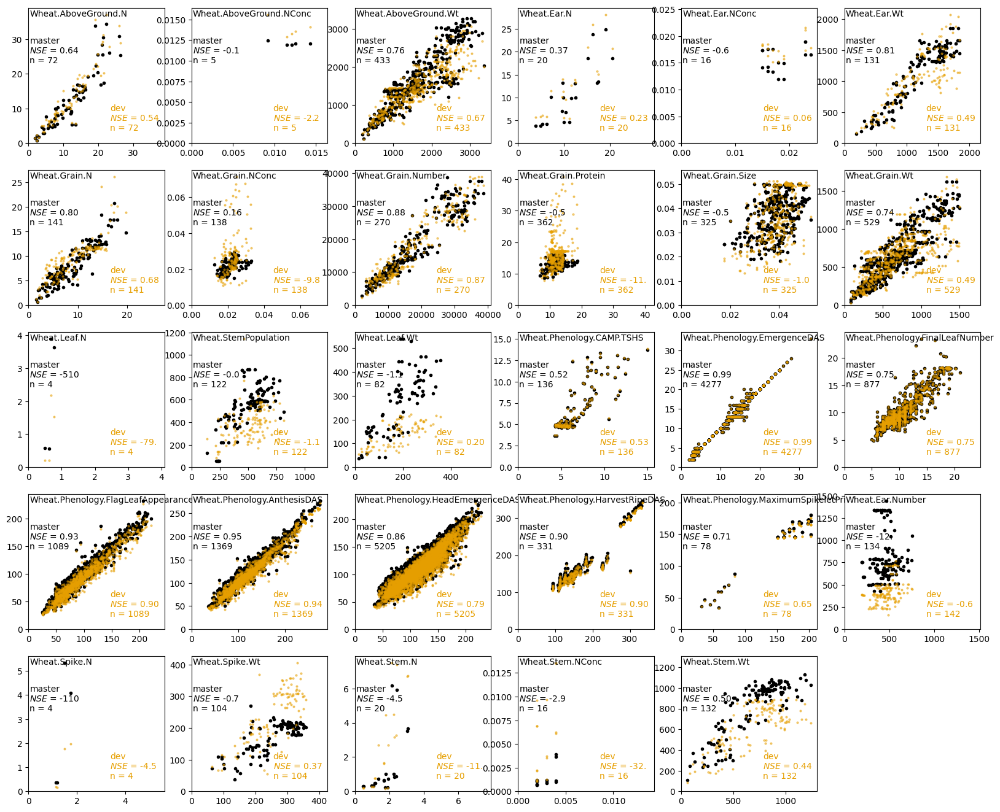

In [11]:
legpos = {"master":[0.01,0.79],"dev":[0.6,0.29]}
HarvGraphs =  plt.figure(figsize=(20,20))
pos=1
for var in HarvVars:
    ax = HarvGraphs.add_subplot(6,6,pos)
    axmax = 0.01
    cpos = 1
    msv = 3
    alpv = 1
    for p in Pair:
        if p=='dev' and var in list(VariableRenames.keys()):
            var = VariableRenames[var]
        obsPred = pd.DataFrame(Pair[p]["obs"].loc[:,var].dropna().copy())
        obsPred.columns = ['obs']
        obsPred.index = obsPred.index.get_level_values(0)
        for s in obsPred.index:
            try:
                obsPred.loc[s,'pred'] = Pair[p]["pred"].loc[s,var].values[0]
            except:
                obsPred.loc[s,'pred'] = np.nan
        obsPred.dropna(inplace=True)
        plt.plot(obsPred.obs,obsPred.pred,'o',ms = msv,color = Colors[cpos],alpha = alpv)
        
        if len(obsPred.pred.dropna())>2:
                n = len(obsPred.obs)
                RegStats = MUte.MathUtilities.CalcRegressionStats('',obsPred.pred,obsPred.obs)
                fitR2 = p+'\n$NSE$ = ' + str(RegStats.NSE)[:4] + '\nn = '+ str(n)
                plt.text(legpos[p][0],legpos[p][1],fitR2,transform=ax.transAxes,horizontalalignment='left', verticalalignment='top',color = Colors[cpos])
                
        if len(obsPred.pred.dropna())>0:
            axmax = max(obsPred.obs.max(),obsPred.pred.max(),axmax)
        cpos +=1
        msv -=1
        alpv *= 0.5
    plt.text(0.01,0.99,var,transform=ax.transAxes,horizontalalignment='left', verticalalignment='top')
    
    plt.ylim(0,axmax*1.05)
    plt.xlim(0,axmax*1.05)   
    pos+=1

In [12]:
# read in daily predicted values
def setDailyPred(filePath, Simulations, HarvestPred):
    con = sqlite3.connect(filePath)
    DailyPred = pd.read_sql("Select * from DailyReport",con)
    con.close()
    DailyPred.loc[:,'SimulationName'] = [Simulations.loc[x,'Name'] for x in DailyPred.SimulationID]
    DailyPred.set_index(['SimulationName','Clock.Today'],drop=False,inplace=True)
    DailyPred.sort_index(inplace=True)
    DailyPred.sort_index(inplace=True,axis=1)
    validationFilter = [x not in SensibilityFolders for x in DailyPred.FolderName]
    DailyPred = DailyPred.loc[validationFilter,:].copy()
    DailyPred.dropna(how='all',axis=1,inplace=True)
    # Replace Experiment with values that have had folder name pathed in where no experiment is present
    DailyPred.loc[:,'Experiment'] = [HarvestPred.loc[x,'Experiment'] for x in DailyPred.index.get_level_values(0)]
    
    ## Join NDVI data into daily obs
    con = sqlite3.connect(filePath)
    NDVIPred = pd.read_sql("Select * from NDVIDailyReport",con)
    con.close()
    NDVIPred.loc[:,'SimulationName'] = [Simulations.loc[x,'Name'] for x in NDVIPred.SimulationID]
    NDVIPred.set_index(['SimulationName','Clock.Today'],drop=False,inplace=True)
    NDVIPred.sort_index(inplace=True)
    NDVIPred.sort_index(inplace=True,axis=1)
    
    validationFilter = [x not in SensibilityFolders for x in NDVIPred.FolderName]
    NDVIPred = NDVIPred.loc[validationFilter,:].copy()
    NDVIPred.dropna(how='all',axis=1,inplace=True)
    ##Join NDVI predictions in with others 
    for i in NDVIPred.index:
        DailyPred.loc[i,'NDVIModel.Script.NDVI'] = NDVIPred.loc[i,'NDVIModel.Script.NDVI']

    return DailyPred

MasterDailyPred = setDailyPred(MasterfilePath, MasterSimulations, MasterHarvestPred)
DevDailyPred = setDailyPred(DevfilePath, DevSimulations, DevHarvestPred)

In [14]:
def subVarName(name):
    varName = name
    try:
        varName = VariableRenames[name]
        return varName
    except:
        return varName

MasterDailyObsIndices = ['Clock.Today',
                'Wheat.Phenology.CurrentStageName',
                'IWeather.Latitude',
                'IWeather.Longitude',
                'LocationInfo.Script.Country',
                'LocationInfo.Script.Region',
                'LocationInfo.Script.State',
                'Wheat.SowingData.Cultivar',
                'Experiment',
                'FolderName']

DevDailyObsIndices = [subVarName(x) for x in MasterDailyObsIndices]

MasterDailyObsVars = ['NDVIModel.Script.NDVI',
                'Wheat.AboveGround.N',
                'Wheat.AboveGround.NConc',
                'Wheat.AboveGround.Wt',
                'Wheat.Ear.N',
                'Wheat.Ear.NConc',
                'Wheat.Ear.Wt',
                'Wheat.Grain.N',
                'Wheat.Grain.NConc',
                'Wheat.Grain.Wt',
                'Wheat.Leaf.CoverGreen',
                'Wheat.Leaf.CoverTotal',
                'Wheat.Leaf.Dead.N',
                'Wheat.Leaf.Dead.NConc',
                'Wheat.Leaf.Dead.Wt',
                'Wheat.Leaf.Height',
                'Wheat.Leaf.LAI',
                'Wheat.Leaf.Live.N',
                'Wheat.Leaf.Live.NConc',
                'Wheat.Leaf.Live.StorageWt',
                'Wheat.Leaf.Live.Wt',
                'Wheat.Leaf.N',
                'Wheat.Leaf.SpecificAreaCanopy',
                'Wheat.Leaf.StemNumberPerPlant',
                'Wheat.Leaf.StemPopulation',
                'Wheat.Leaf.Wt',
                'Wheat.Phenology.HaunStage',
                'Wheat.Phenology.Zadok.Stage',
                'Wheat.Spike.N',
                'Wheat.Spike.NConc',
                'Wheat.Spike.Live.StorageWt',
                'Wheat.Spike.Wt',
                'Wheat.Stem.N',
                'Wheat.Stem.NConc',
                'Wheat.Stem.Live.StorageWt',
                'Wheat.Stem.Wt',
                '(Wheat.Leaf.Transpiration + ISoilWater.Es + MicroClimate.PrecipitationInterception)',
                'sum(Soil.Water.MM)',
                'Soil.Water.Volumetric(1)']

DevDailyObsVars = [subVarName(x) for x in MasterDailyObsVars]

MasterDailyObsIndicesAndVars = MasterDailyObsIndices+MasterDailyObsVars
DevDailyObsIndicesAndVars = DevDailyObsIndices+DevDailyObsVars

MasterDailyObs = MasterObserved.loc[~MasterObserved.loc[:,'Clock.Today'].isnull(),MasterDailyObsIndicesAndVars]
MasterDailyObs.dropna(axis=1,how="all",inplace=True)
MasterDailyObs.dropna(axis=0,how="all",inplace=True)

DevDailyObs = DevObserved.loc[~DevObserved.loc[:,'Clock.Today'].isnull(),DevDailyObsIndicesAndVars]
DevDailyObs.dropna(axis=1,how="all",inplace=True)
DevDailyObs.dropna(axis=0,how="all",inplace=True)

In [15]:
MasterIndexVars = ['Clock.Today',
'IWeather.MaxT',
'IWeather.MinT',
'IWeather.Radn',
'SimulationID',
'SimulationName',
'Wheat.DaysAfterSowing',
'Wheat.Phenology.AccumulatedTT',
'Wheat.Phenology.PTQ',
'Wheat.Phenology.CurrentPhaseName',
'Wheat.Phenology.CurrentStageName',
'Wheat.Phenology.Stage']

DevIndexVars = [subVarName(x) for x in MasterIndexVars]

for iv in MasterIndexVars:
    MasterDailyObs.loc[:,iv] = MasterDailyPred.reindex(MasterDailyObs.index).loc[:,iv]
    
for iv in DevIndexVars:
    DevDailyObs.loc[:,iv] = DevDailyPred.reindex(DevDailyObs.index).loc[:,iv]
    
MasterDailyResidules = MasterDailyObs.copy()
DevDailyResidules = DevDailyObs.copy()
for ov in MasterDailyObsVars:
    MasterDailyResidules.loc[:,ov] = MasterDailyObs.loc[:,ov] - MasterDailyPred.reindex(MasterDailyObs.index).loc[:,ov]
for ov in DevDailyObsVars:
    DevDailyResidules.loc[:,ov] = DevDailyObs.loc[:,ov] - DevDailyPred.reindex(DevDailyObs.index).loc[:,ov]

In [16]:
#Make data frame with factor information for each simulation
FactorList = [ 'Experiment',
 'Canopy',
 'Cm',
 'Cultivar',
 'Cv',
 'Date',
 'Durat',
 'Fungicide',
 'Grazed',
 'Irr',
 'Irrig',
 'Mgmt',
 'N',
 'NRate',
 'Nit',
 'Nutrition',
 'P',
 'PGR',
 'Popn',
 'Removal',
 'RowSpace',
 'SD',
 'Seeds',
 'Soil',
 'Sow',
 'SowN',
 'Stubble',
 'TOS',
 'TopN',
 'Treat',
 'Treatment',
 'V',
 'Water']

Factors = MasterHarvestPred.loc[:,FactorList].copy()
Factors.index = Factors.index.droplevel(1)
Factors.set_index('Experiment',append=True,inplace=True)
Factors=Factors.reorder_levels(['Experiment','SimulationName'])
Factors.sort_index(inplace=True)
CondensedFactors = pd.DataFrame(index = Factors.index,columns = ['fName1','fValue1'])
for s in Factors.index:
    fs = Factors.loc[s,:].dropna().to_dict()
    fCount = 1
    for key, value in fs.items():
        CondensedFactors.loc[s,'fName'+str(fCount)] = key
        CondensedFactors.loc[s,'fValue'+str(fCount)] = value
        fCount +=1
valueLabs = ['fValue1','fValue2','fValue3','fValue4']
indexLabs = ['fIndex1','fIndex2','fIndex3','fIndex4']
CondensedFactors.loc[:,indexLabs]=1

# put simulation names in as first factor level for sims that are not in a experiment
for e in MasterExperiments:
    fValues1 = CondensedFactors.loc[e,'fValue1']
    if True in pd.isna(fValues1.values):
        CondensedFactors.loc[e,'fValue1'] = CondensedFactors.loc[e,:].index.values
        
#assign numeric index to each factor level
def dicMaker(fLevels):
    thisDic = {}
    num = 1
    for f in fLevels:
        thisDic.update({f:num})
        if num <28:
            num+=1
        else:
            num = 1
    return thisDic

for e in MasterExperiments:
    for v in valueLabs:
        fLevels = CondensedFactors.loc[e,v].drop_duplicates().values
        if False in pd.isna(fLevels):
            levelDic = dicMaker(fLevels)
            CondensedFactors.loc[e,v.replace('Value','Index')] = [levelDic[x] for x in CondensedFactors.loc[e,v]]

In [17]:
MasterDaily = {"obs":MasterDailyObs,"pred":MasterDailyPred,"res":MasterDailyResidules}
DevDaily = {"obs":DevDailyObs,"pred":DevDailyPred,"res":DevDailyResidules}
DailyPair = {"master":MasterDaily,"dev":DevDaily}

In [18]:
def residualGraph(ind,var,gro,figsize = (20,10),legends=True):
    Graph = plt.figure(figsize=figsize)
    ymax = max(DailyPair["master"]["res"].loc[:,var["master"]].max(),DailyPair["dev"]["res"].loc[:,var["dev"]].max())*1.01
    ymin = min(DailyPair["master"]["res"].loc[:,var["master"]].min(),DailyPair["dev"]["res"].loc[:,var["dev"]].min())*1.01
    absMax = max(ymax,ymin*-1)
    ymin = absMax * -1
    xmax = max(DailyPair["master"]["res"].loc[:,ind].max(),DailyPair["dev"]["res"].loc[:,ind].max())*1.01
    pos=1
    for dp in DailyPair:
        ax = Graph.add_subplot(1,2,pos)
        colPos = 1
        markerPos = 1
        if dp=='master':
            plt.ylabel(var[dp]+" (Obs - Pred)")
        plotSet = DailyPair[dp]["res"].dropna(subset=[ind,var[dp]]).loc[:,[ind,var[dp],gro]]
        Groups = list(plotSet.Experiment.drop_duplicates().values)
        for g in Groups:
            groupSet = plotSet.loc[plotSet.loc[:,gro] == g,:]
            SimsToGraph = list(groupSet.index.get_level_values(0).drop_duplicates())
            for s in SimsToGraph:
                data = DailyPair[dp]["res"].loc[s,[ind,var[dp]]].dropna()
                x = data.loc[:,ind]
                y = data.loc[:,var[dp]]
                plt.plot(x,y,Markers[markerPos]+'-',lw=1,ms=7,color = Colors[colPos],label=g)
            colPos +=1
            if colPos>8:
                colPos=1
                markerPos +=1
        
        allobs = DailyPair[dp]["obs"].loc[:,var[dp]].dropna()
        allpred = DailyPair[dp]["pred"].reindex(allobs.index).loc[:,var[dp]]
        if len(allobs.dropna())>2:
            n = len(allobs)
            RegStats = MUte.MathUtilities.CalcRegressionStats('',allpred,allobs)
            fitR2 = dp+'\n$NSE$ = ' + str(RegStats.NSE)[:4] + '\nn = '+ str(n)
            plt.text(0.05,0.95,fitR2,transform=ax.transAxes,horizontalalignment='left', verticalalignment='top')
        plt.ylim(ymin,absMax)
        plt.xlim(0,xmax)
        pos+=1
        plt.xlabel(ind)
    if legends == True:
        AddLegend(LegLoc=(1.05,1.05),labelsize=12,Title='Experiment')
    plt.close("Graph")

def AddLegend(LegLoc, labelsize, Title, NCol = 1,MScale=1):
    labels, handles = GH.DedupLegendElements()
    ledg = plt.legend(labels, handles,bbox_to_anchor=LegLoc,numpoints=1,fontsize = labelsize,labelspacing = 0.05, 
                          title=Title,ncol=NCol,markerscale=MScale)
    ledg.get_title().set_fontsize(labelsize + 2)
    
def timeSeriesGraph(ind,var,gro,legends=False,cols=3,yfix=True):
    plotSet = DailyPair["master"]["res"].dropna(subset=[var['master'],ind]).loc[:,[ind,var['master'],gro]]
    ymax = max(DailyPair["master"]["obs"].loc[:,var['master']].max(),DailyPair["master"]["pred"].loc[:,var['master']].max())*1.01
    GroupsToCheck = list(plotSet.Experiment.drop_duplicates().values)
    GroupsToGraph = []
    for g in GroupsToCheck:
        toGraph = False
        simsToCheck = plotSet.loc[plotSet.Experiment==g,:].index.get_level_values(0).drop_duplicates()
        for s in simsToCheck:
            n = len(plotSet.loc[s,:].index.get_level_values(0))
            if n > 1:
                toGraph = True
        if toGraph == True:
            GroupsToGraph.append(g)
    figsize = (20,np.ceil(len(GroupsToGraph)/3)*4)
    Graph = plt.figure(figsize=figsize)
    colPos = 1
    Pos = 1
    rows = int(np.ceil(len(GroupsToGraph)/cols))
    for g in GroupsToGraph:
        markerPos = 1
        ax = Graph.add_subplot(rows,cols,Pos)
        groupSet = plotSet.loc[plotSet.loc[:,gro] == g,:]
        SimsToGraph = list(groupSet.index.get_level_values(0).drop_duplicates())
        for s in SimsToGraph:
            scol = Colors[CondensedFactors.loc[(g,s),'fIndex1']]
            slin = Lines[CondensedFactors.loc[(g,s),'fIndex2']]
            smar = Markers[CondensedFactors.loc[(g,s),'fIndex2']]
            obs = DailyPair["master"]["obs"].loc[s,[ind,var['master']]].dropna()
            obsX = obs.loc[:,ind]
            obsY = obs.loc[:,var['master']]
            plt.plot(obsX,obsY,smar,ms=5,color = scol,label=s.replace(g,''))

            pred = DailyPair["master"]["pred"].loc[s,[ind,var['master']]].dropna()
            predX = pred.loc[:,ind].where( pred.loc[:,ind] > 1.0,np.nan)
            predY = pred.loc[:,var['master']]
            plt.plot(predX,predY,'--',lw=2,color = scol,alpha=0.4)

            pred = DailyPair["dev"]["pred"].loc[s,[ind,var['dev']]].dropna()
            predX = pred.loc[:,ind].where( pred.loc[:,ind] > 1.0,np.nan)
            predY = pred.loc[:,var['dev']]
            plt.plot(predX,predY,'-',lw=1,color = scol)

        if yfix == True:
            plt.ylim(0,ymax)
        plt.text(0.01,0.99,g,horizontalalignment='left', verticalalignment='top', transform=ax.transAxes)
        Pos +=1
        
        plt.ylabel(var["master"])
        if legends == True:
            GH.AddLegend(LegLoc=2,labelsize=12,Title='Experiment')
    plt.close("Graph")

    
def makeGraphs(var):
    if var in list(VariableRenames.keys()):
        varDic = {"master":var,"dev":VariableRenames[var]}
    else:
        varDic = {"master":var,"dev":var}
    residualGraph(ind = 'Wheat.Phenology.Stage',
              var = varDic,
              gro = 'Experiment',
              figsize = (20,10))
    timeSeriesGraph(ind = 'Wheat.Phenology.Stage',
                var = varDic,
                gro = 'Experiment')

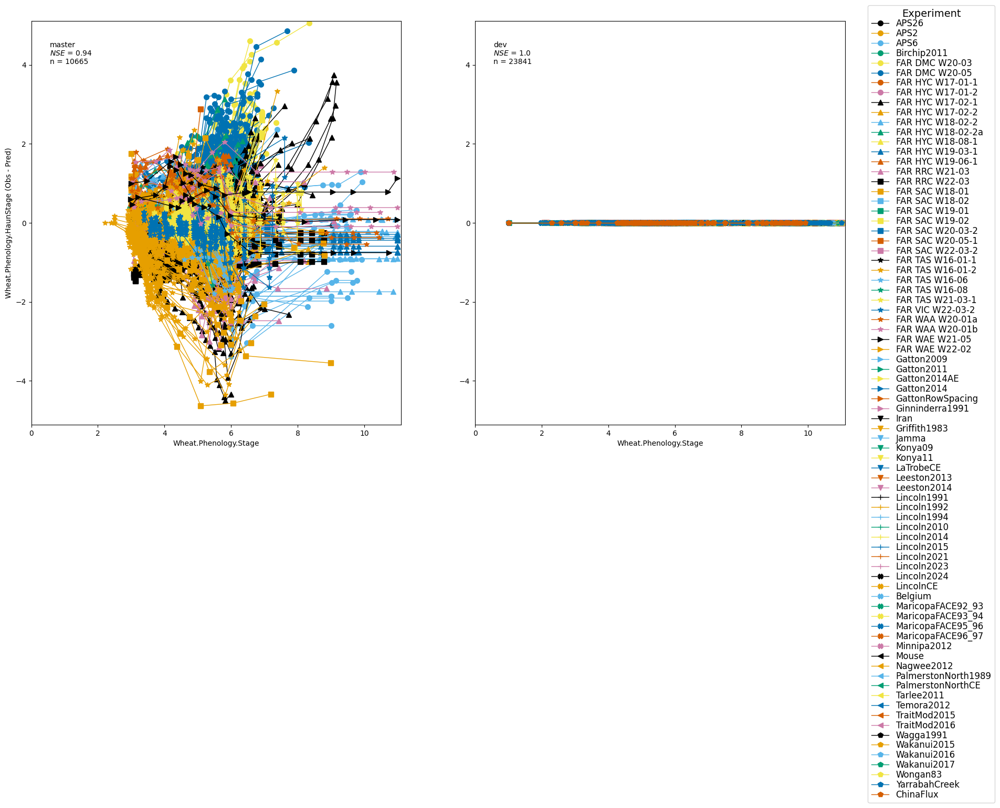

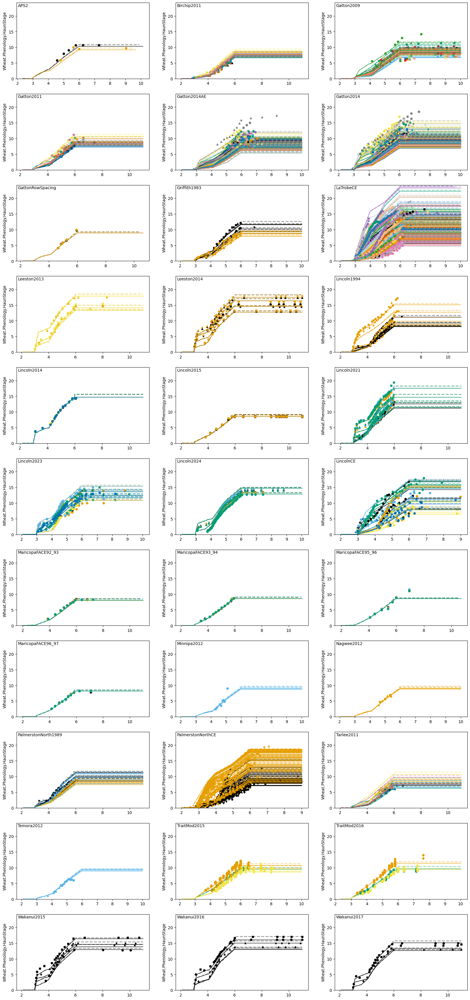

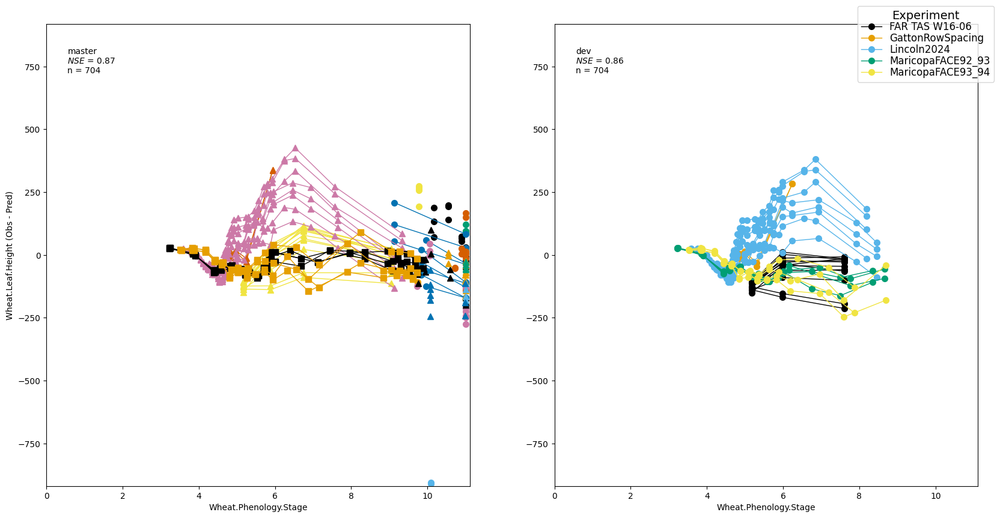

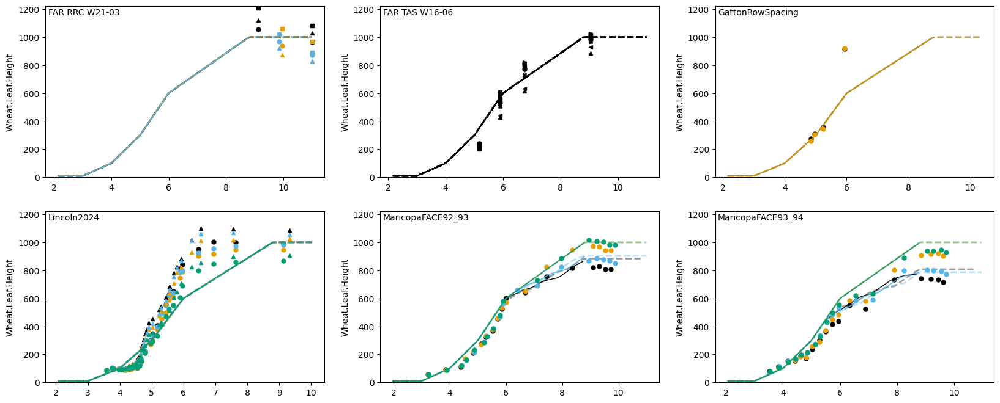

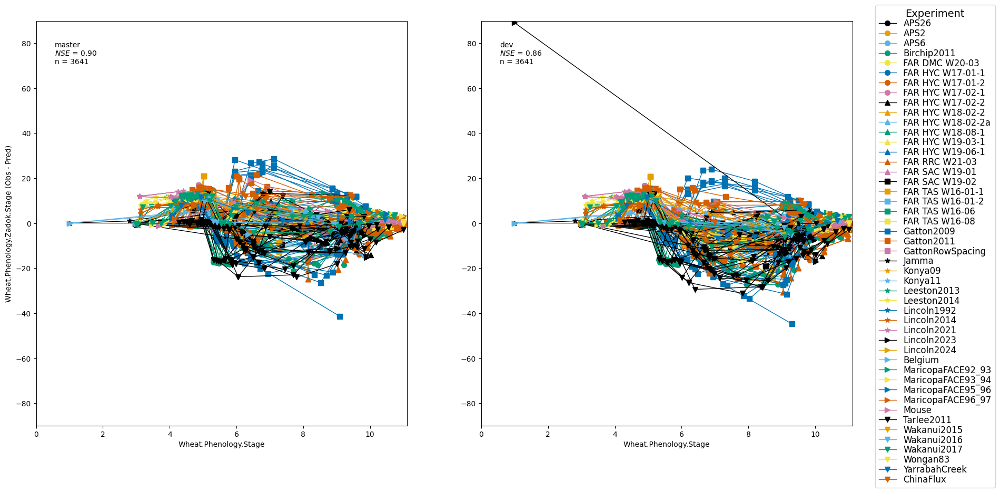

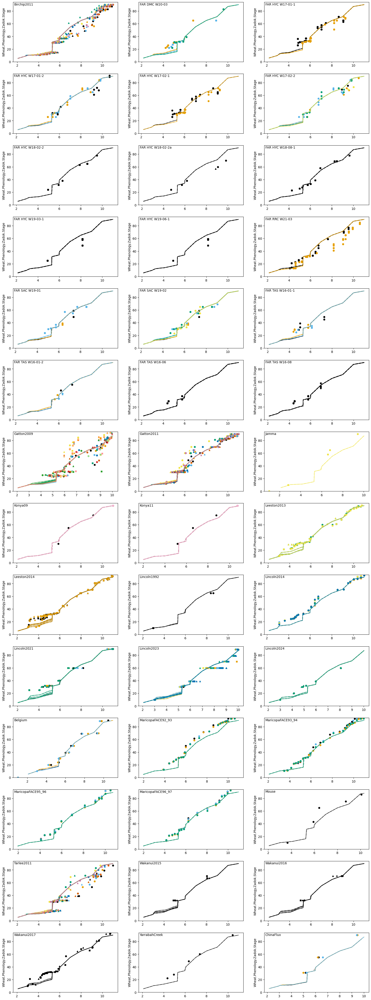

In [20]:
# Graph phenology stuff 

PhenologySet = ['Wheat.Phenology.HaunStage',
                'Wheat.Leaf.Height',
                'Wheat.Phenology.Zadok.Stage',]

for var in PhenologySet:
    try:
        makeGraphs(var)
    except:
        print(var)

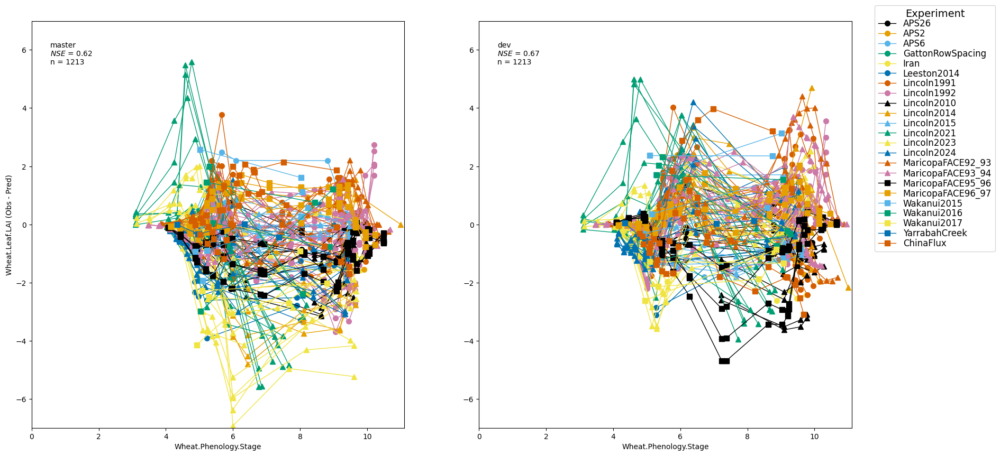

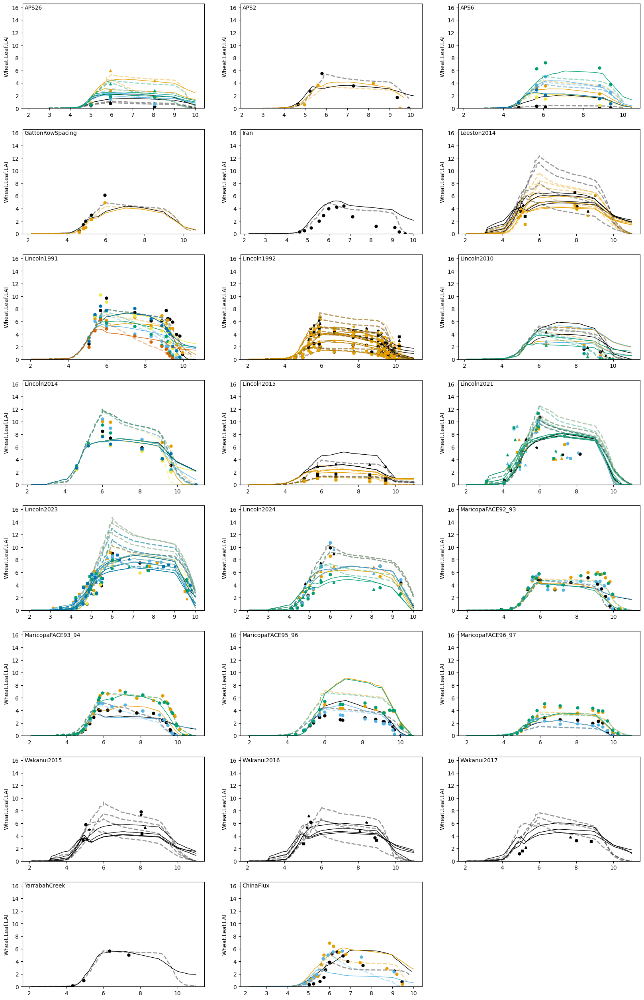

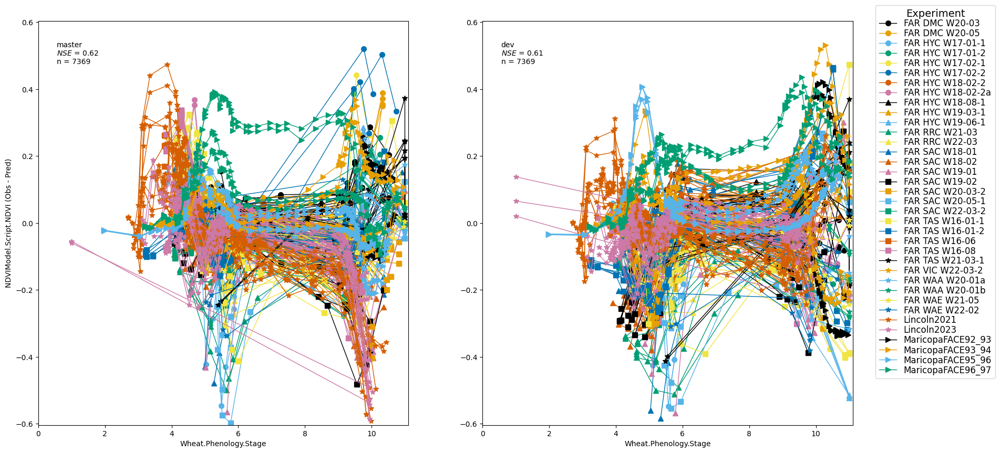

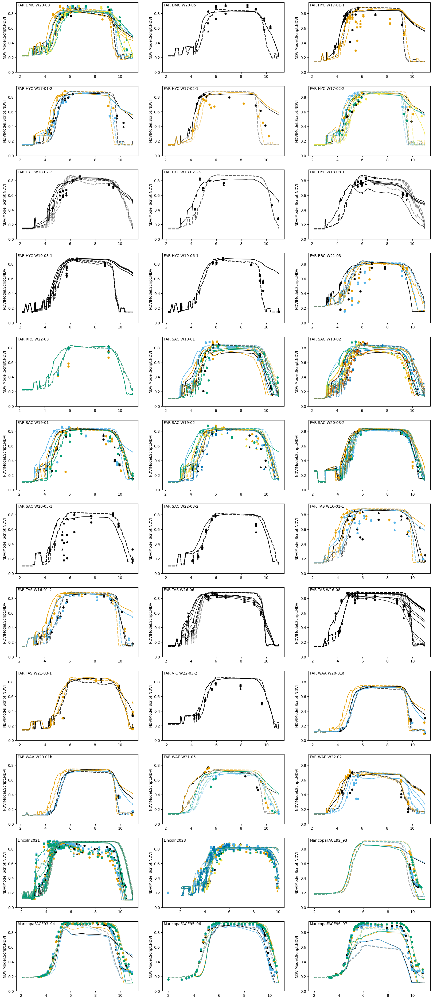

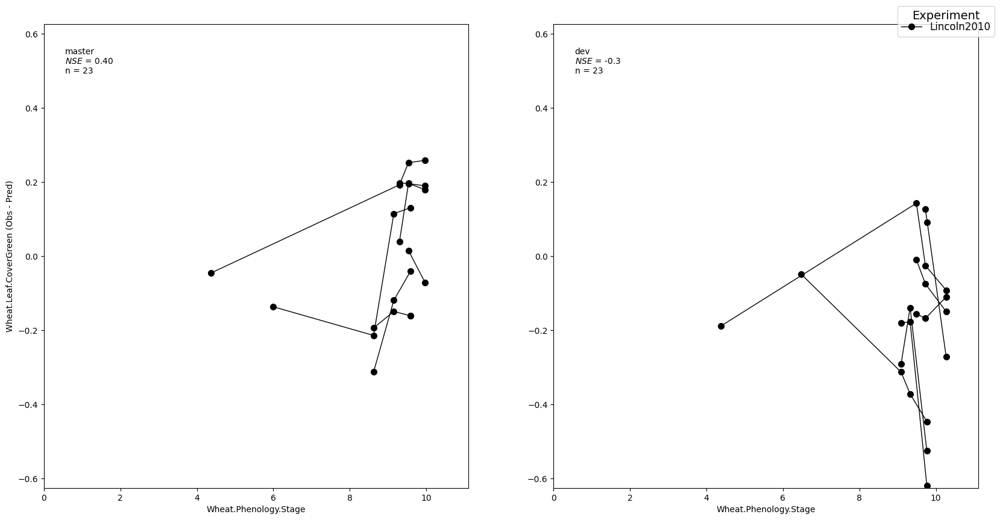

...

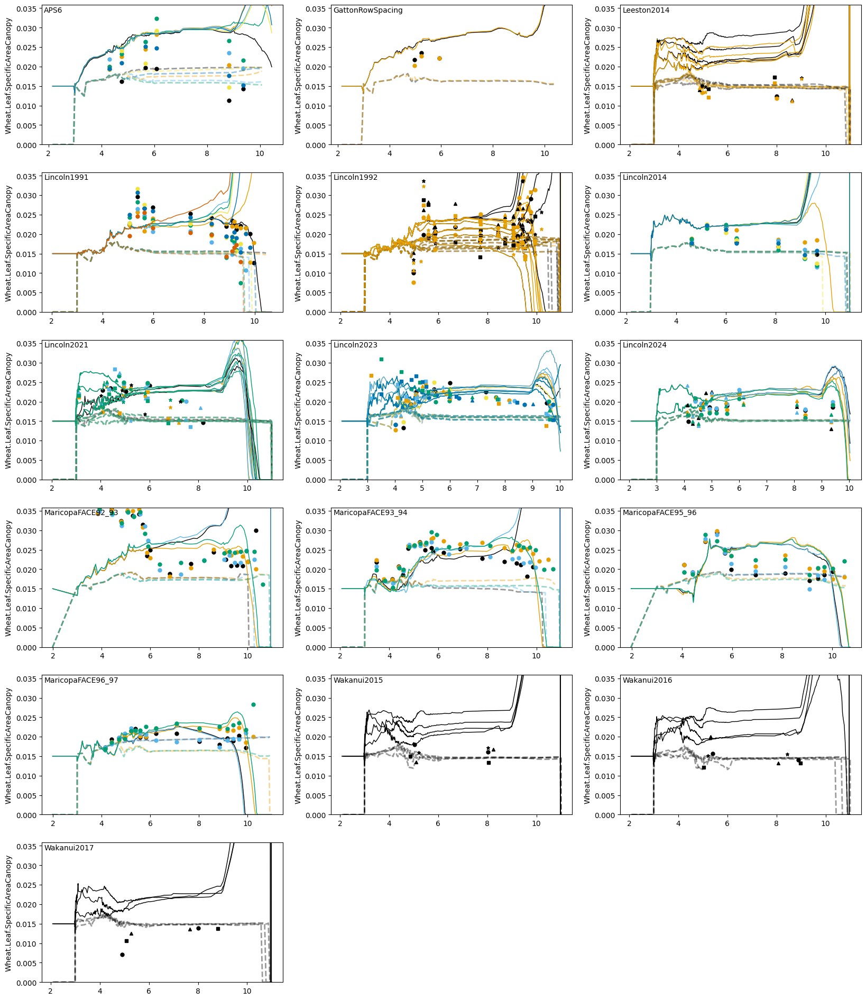

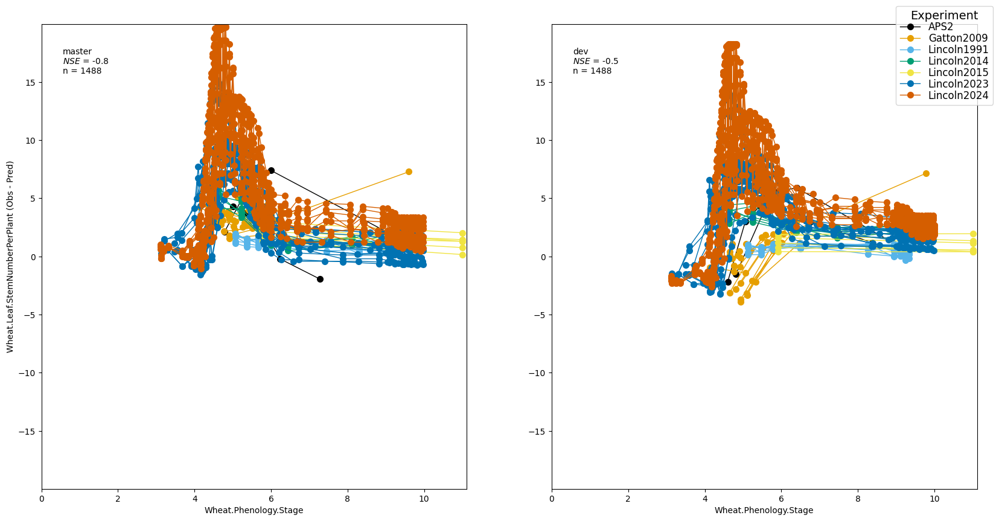

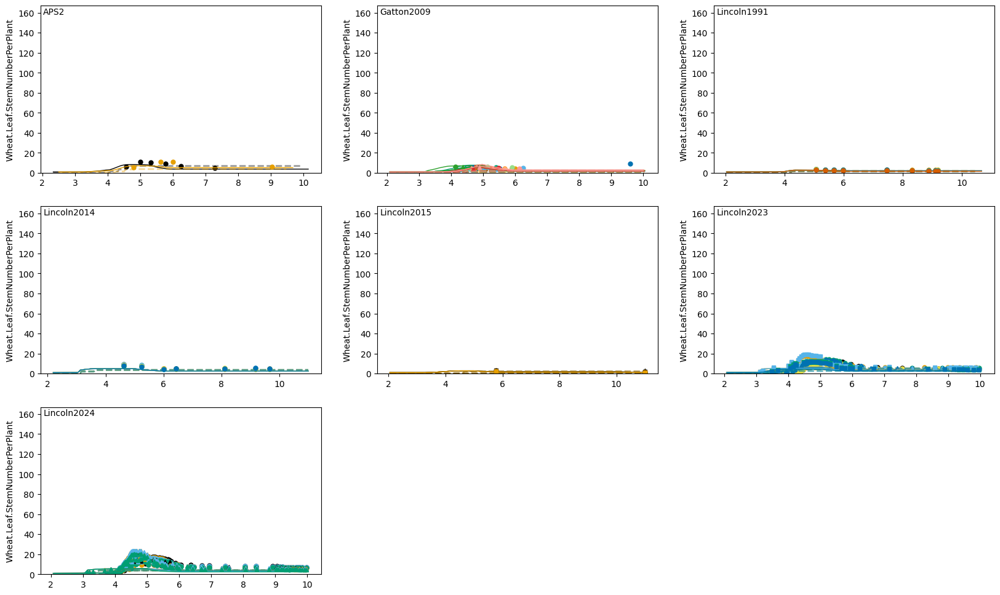

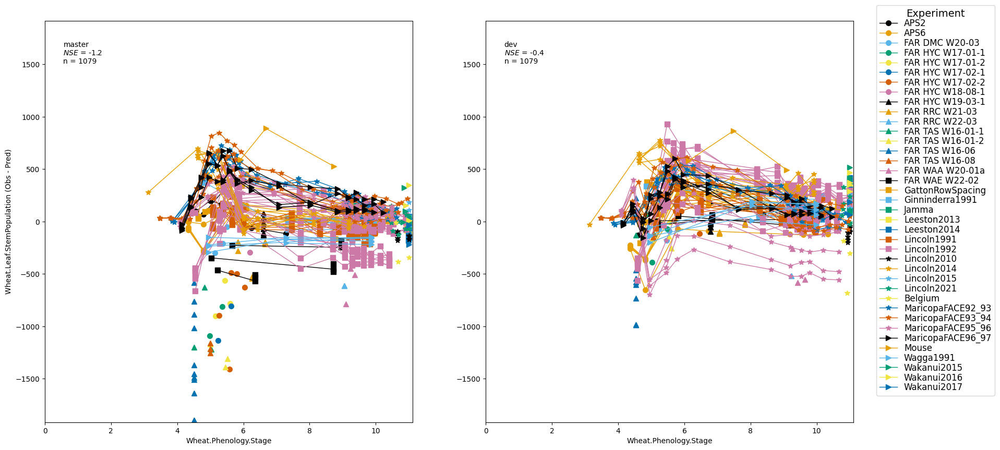

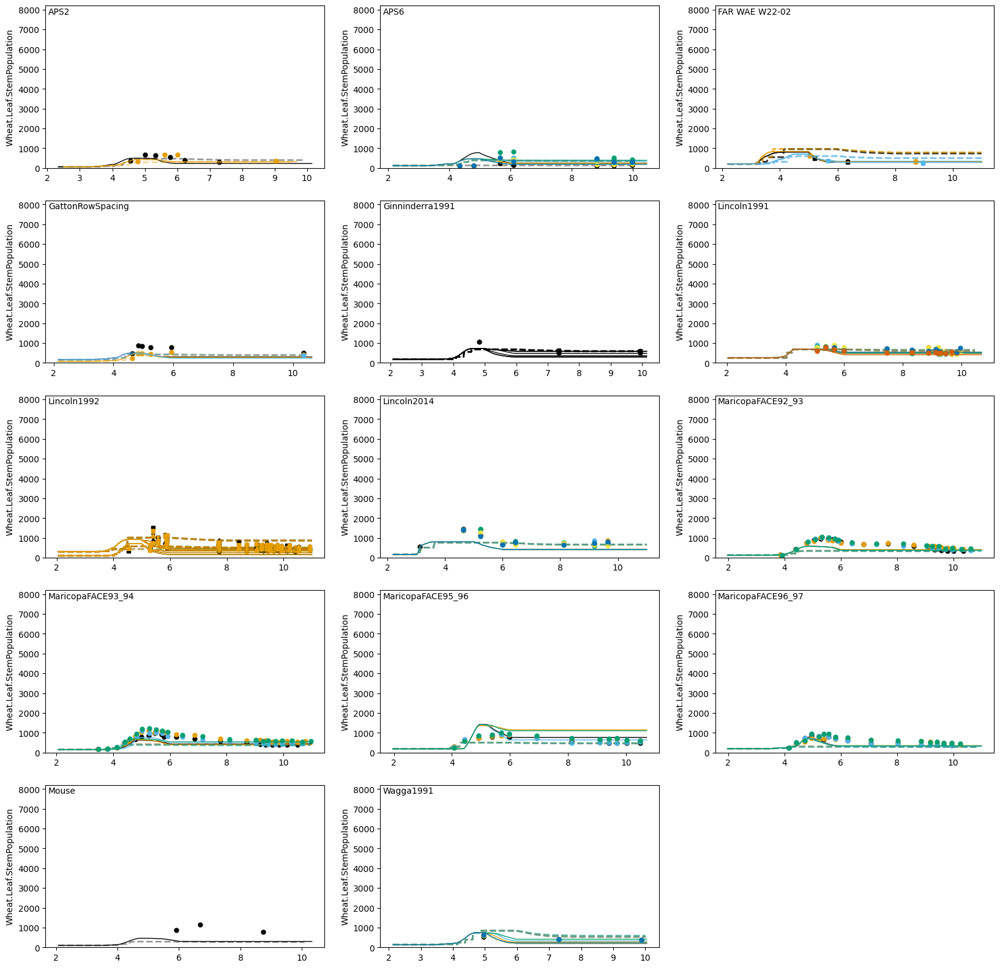

In [21]:
# Graph Canopy stuff  

CanopySet = ['Wheat.Leaf.LAI',
             'NDVIModel.Script.NDVI',
             'Wheat.Leaf.CoverGreen',
             'Wheat.Leaf.CoverTotal',
             'Wheat.Leaf.Live.Wt',
             'Wheat.Leaf.Wt',
             'Wheat.Leaf.SpecificAreaCanopy',
             'Wheat.Leaf.StemNumberPerPlant',
             'Wheat.Leaf.StemPopulation',
             ]

for var in CanopySet:
    try:
        makeGraphs(var)
    except:
        print(var)

C:\Users\Cflhxb\AppData\Local\anaconda3\lib\MathsUtilities.py:763: RuntimeWarning: invalid value encountered in scalar divide
  stats.R2 = 1.0 - (RESIDSS / TSS) # Unadjusted R2 calculated from SS
C:\Users\Cflhxb\AppData\Local\anaconda3\lib\MathsUtilities.py:763: RuntimeWarning: invalid value encountered in scalar divide
  stats.R2 = 1.0 - (RESIDSS / TSS) # Unadjusted R2 calculated from SS
C:\Users\Cflhxb\AppData\Local\Temp\ipykernel_3400\469664218.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  Graph = plt.figure(figsize=figsize)


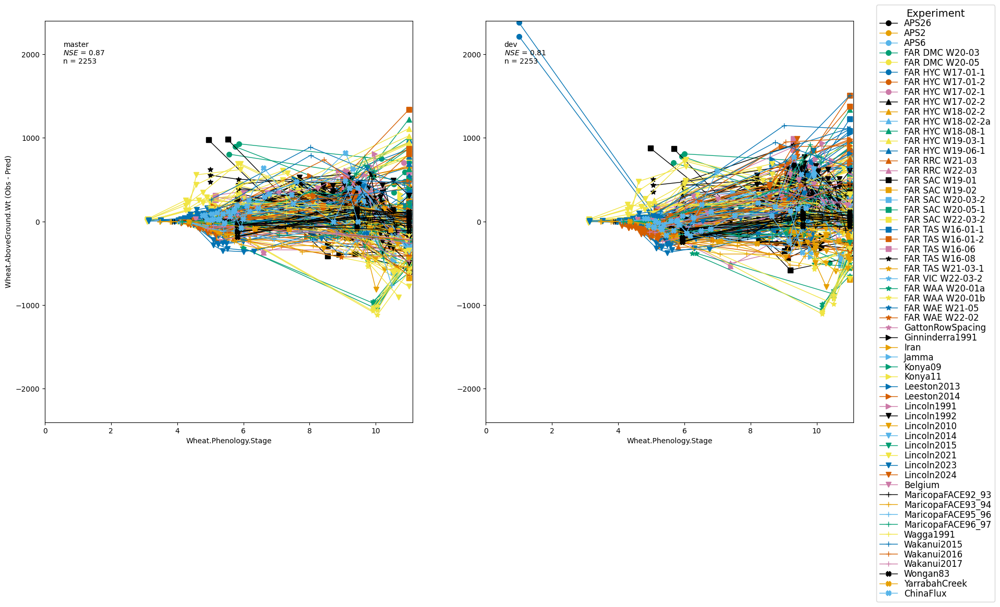

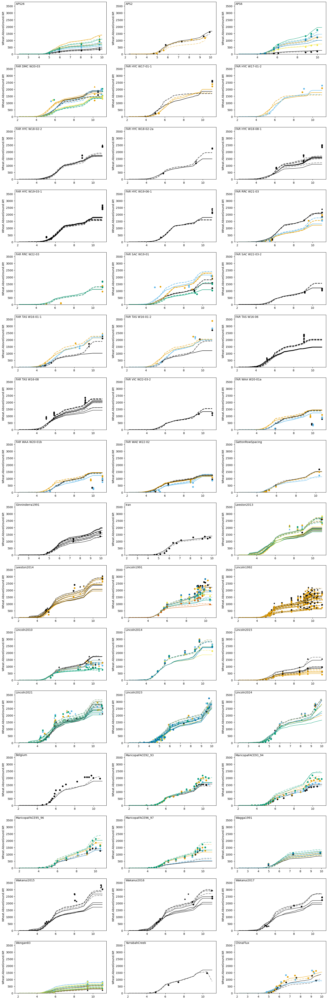

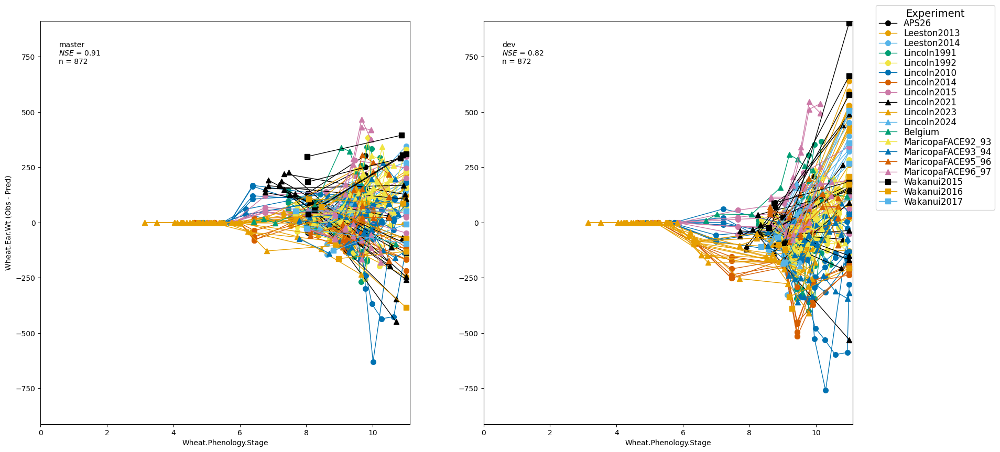

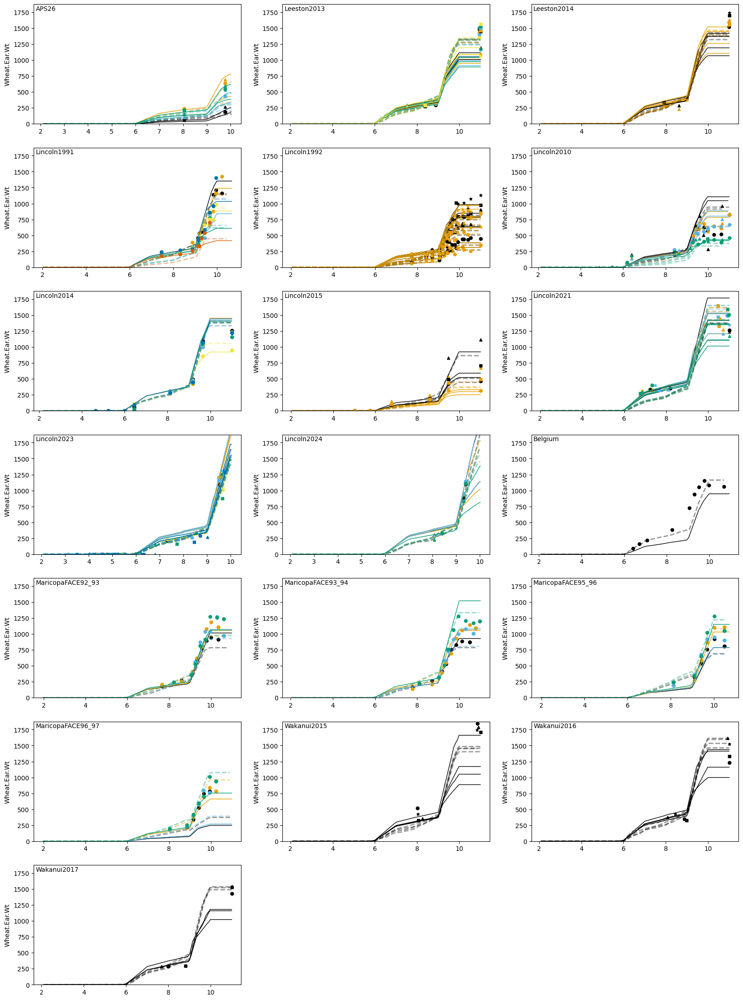

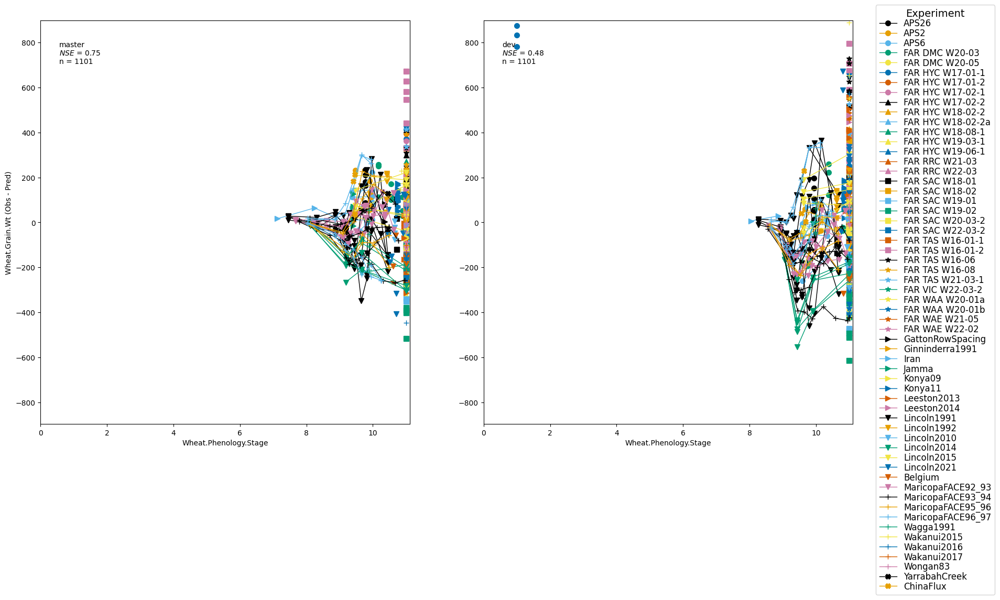

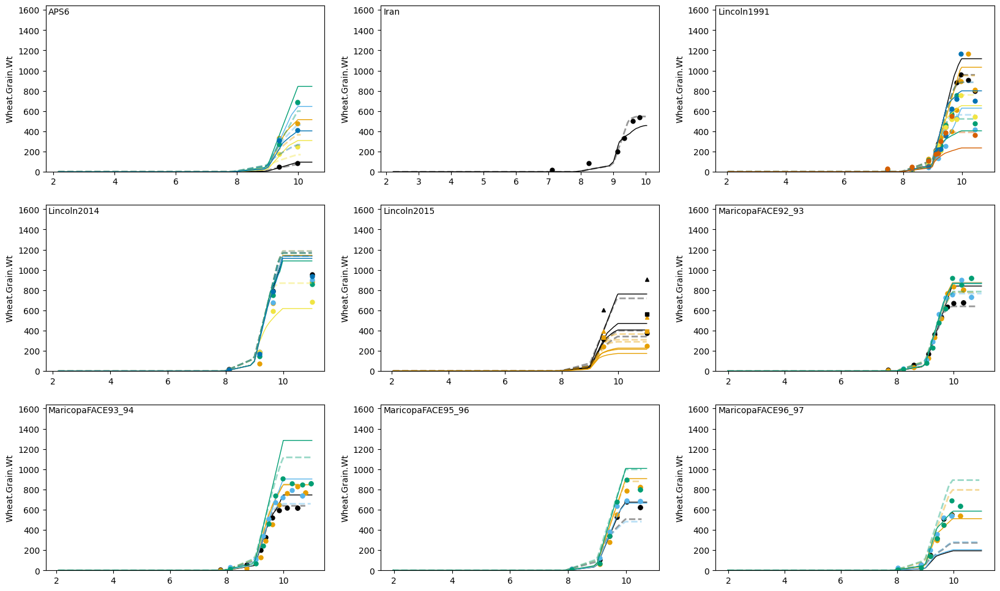

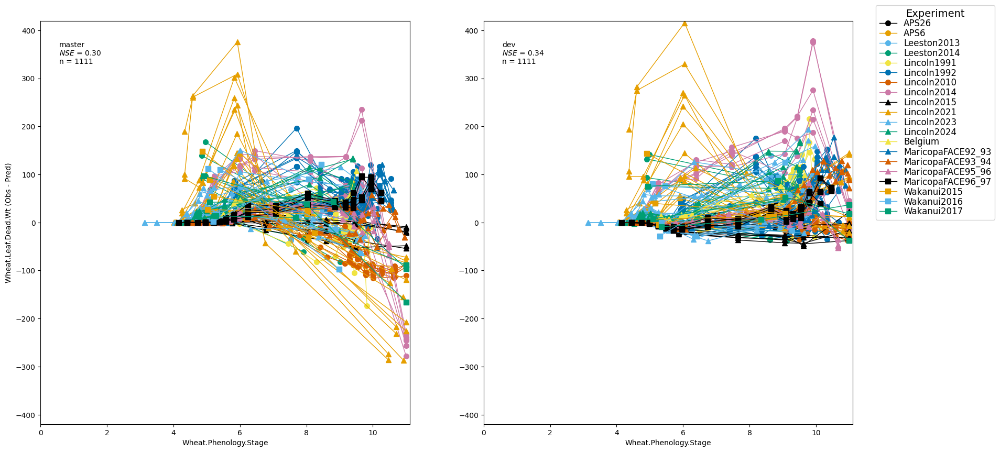

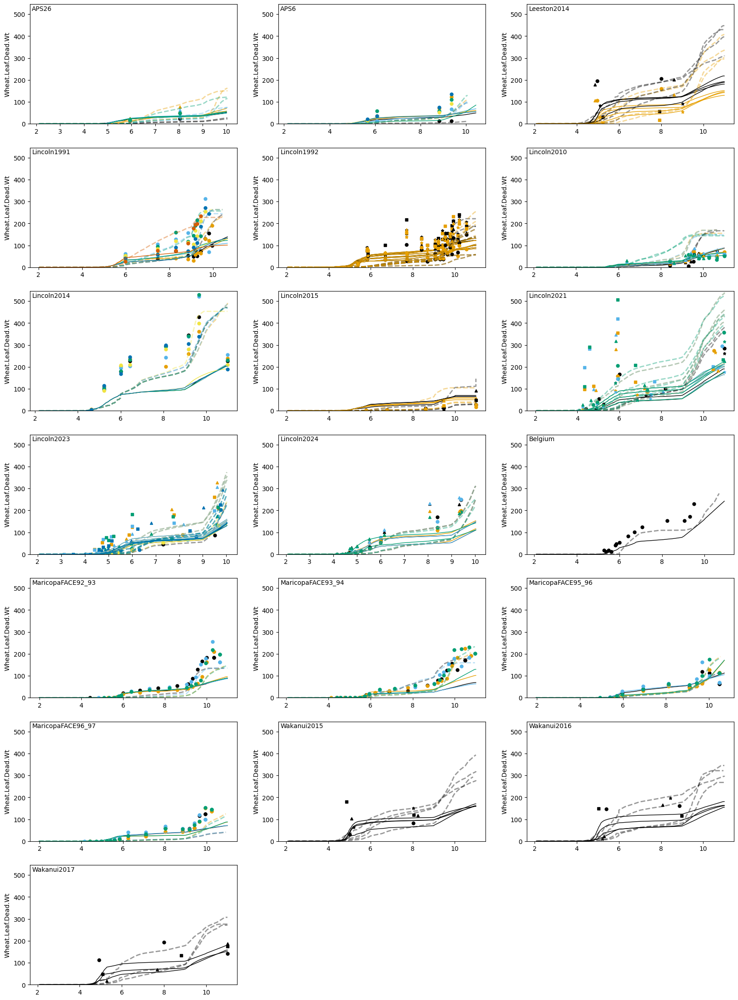

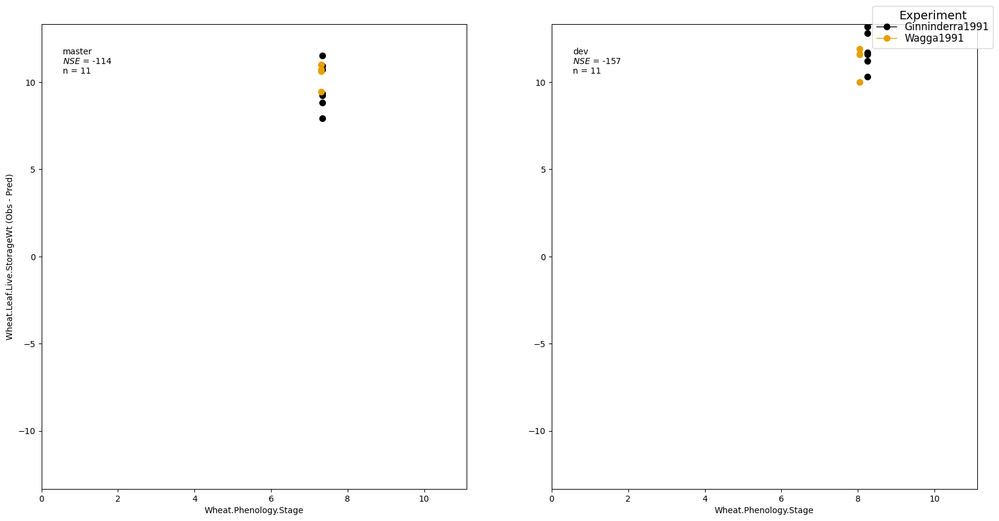

<Figure size 2000x0 with 0 Axes>

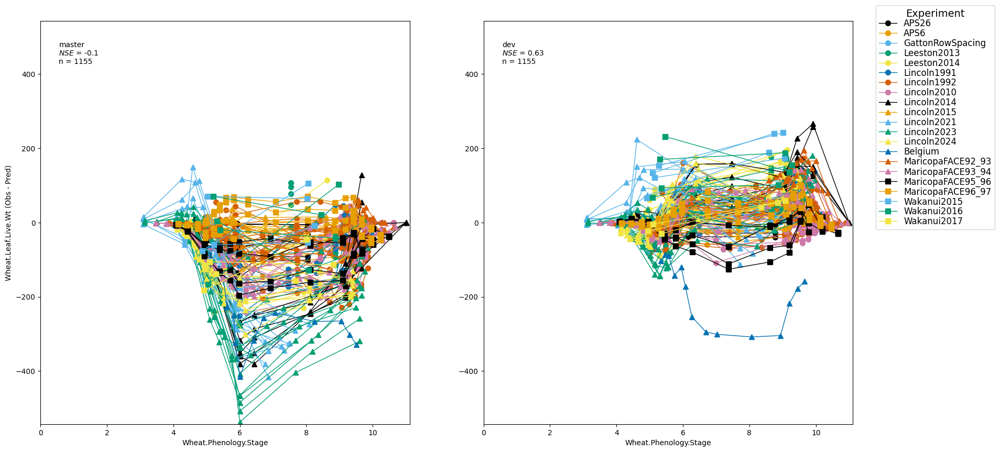

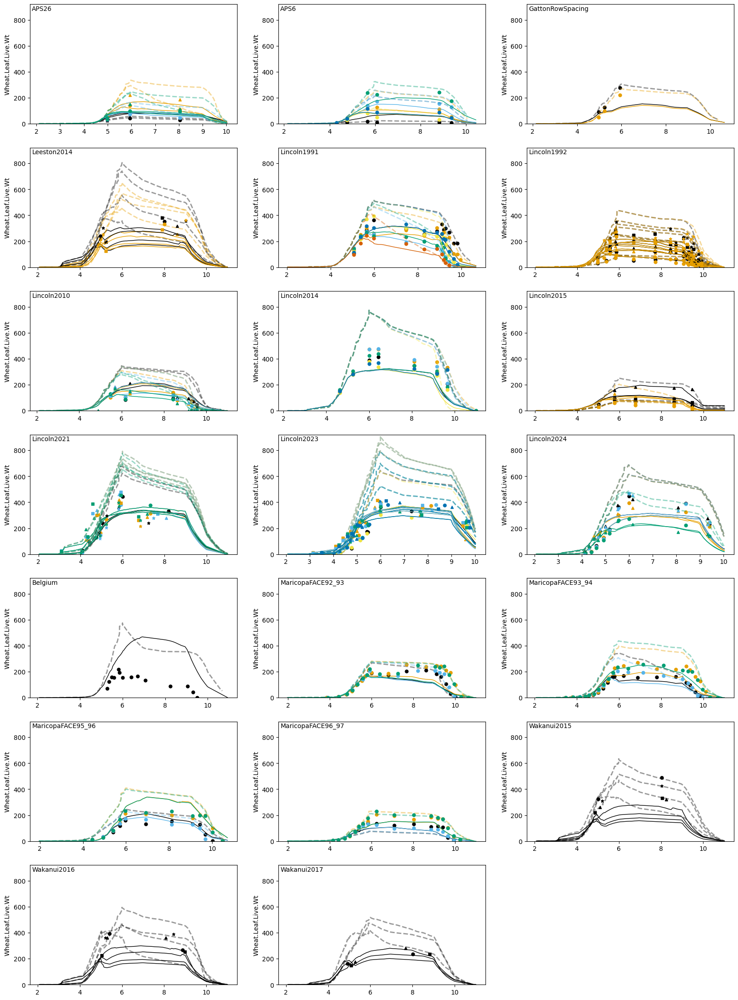

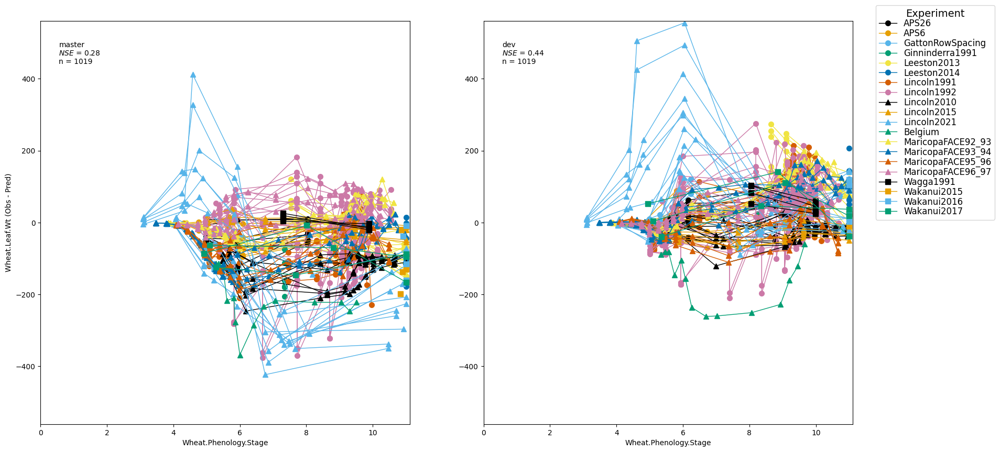

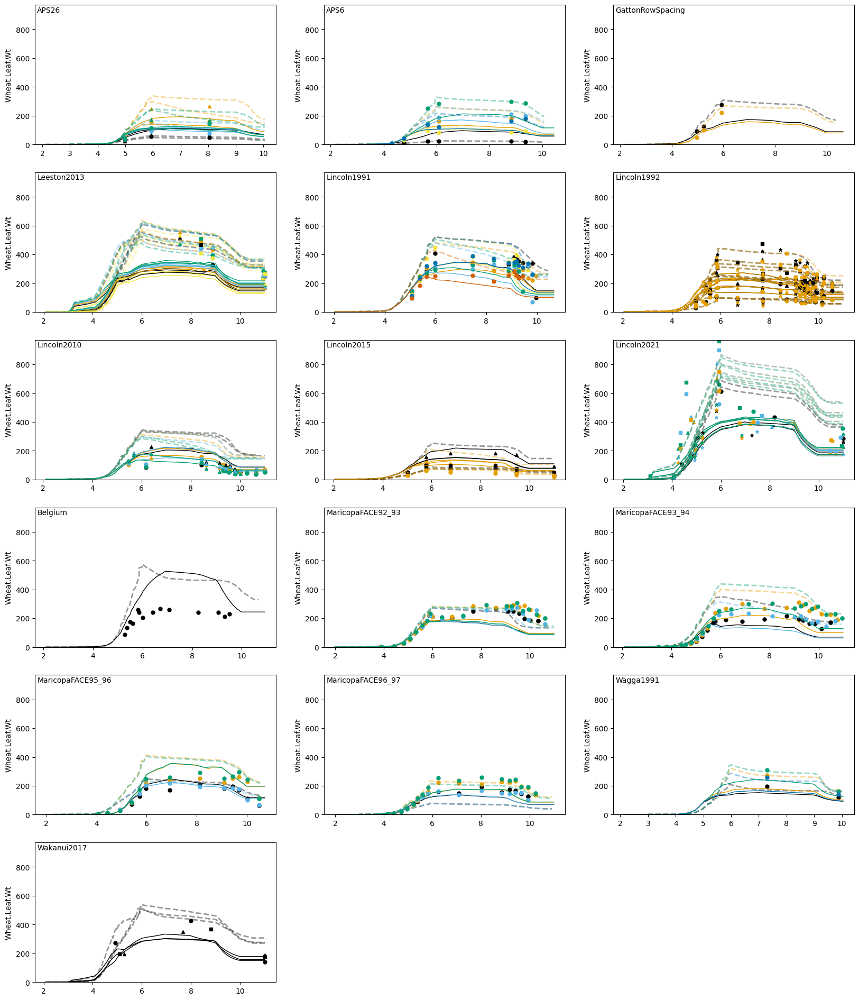

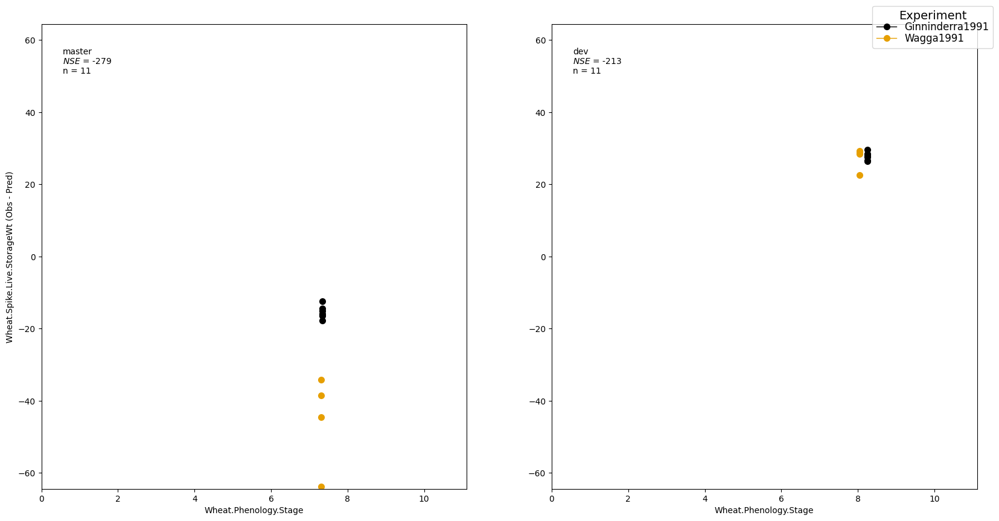

<Figure size 2000x0 with 0 Axes>

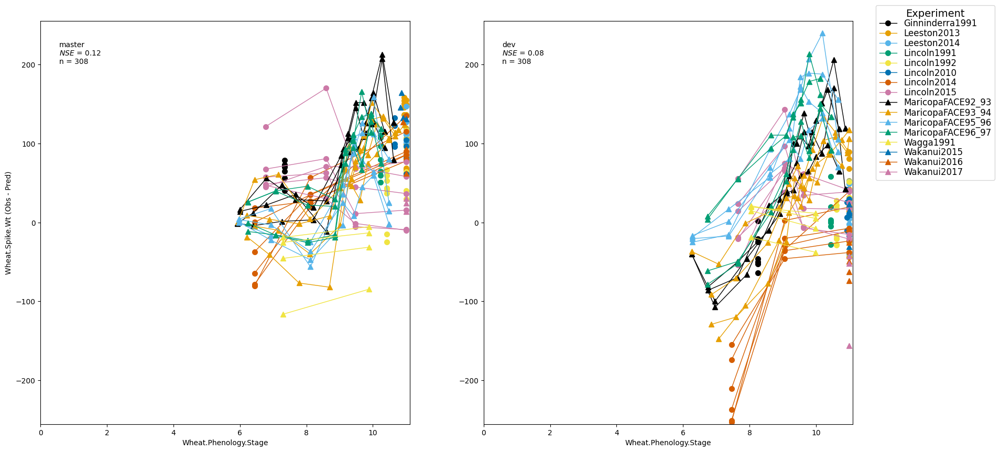

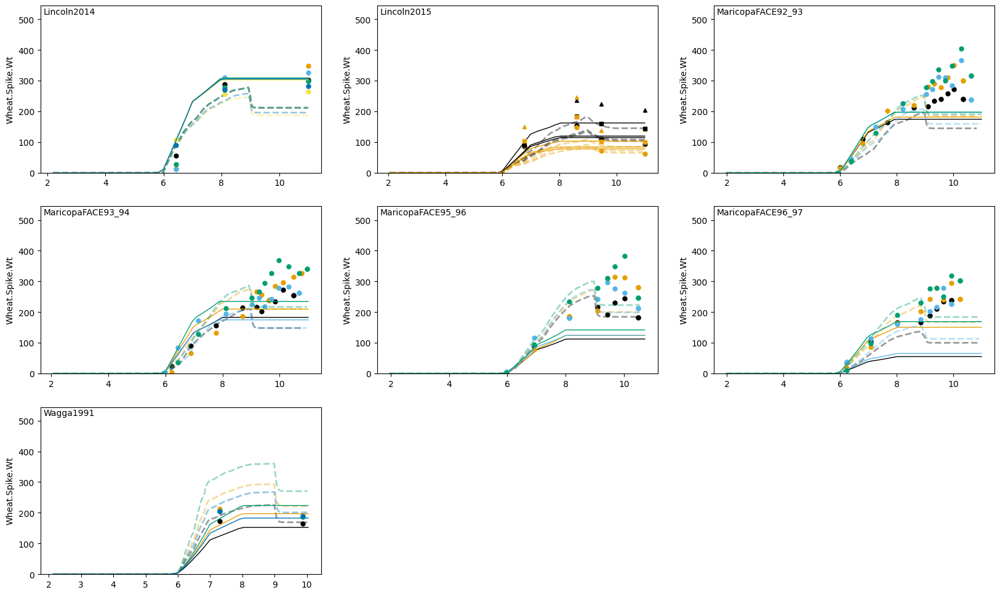

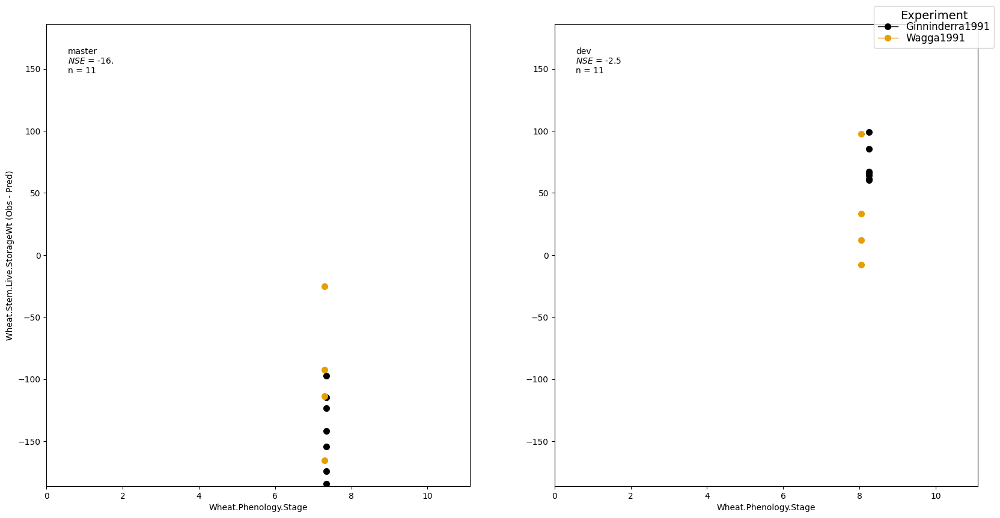

<Figure size 2000x0 with 0 Axes>

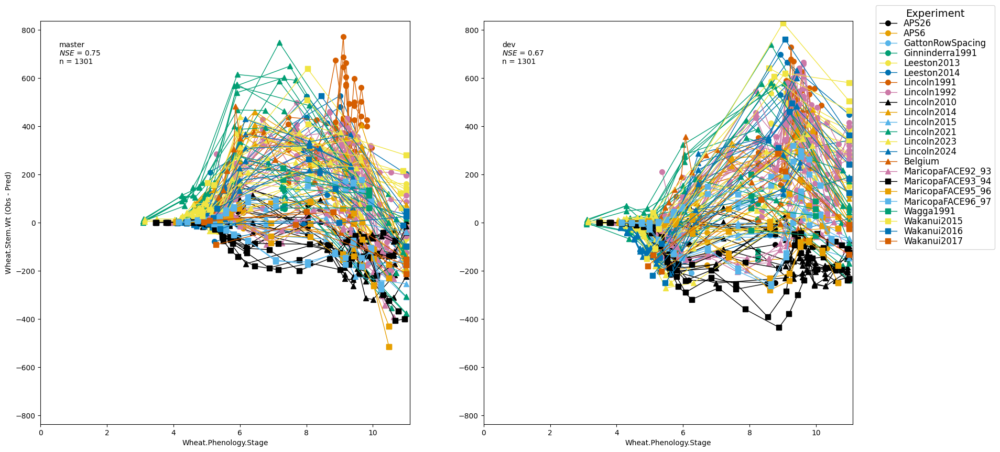

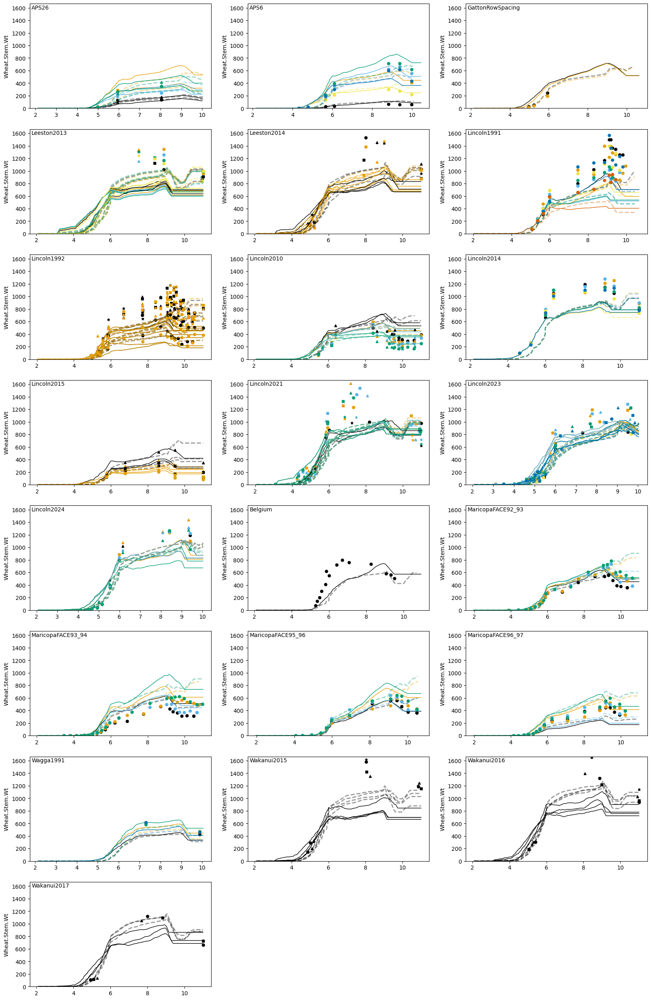

In [22]:
#Graph biomass stuff

BiomassSet = ['Wheat.AboveGround.Wt',
             'Wheat.Ear.Wt',
             'Wheat.Grain.Wt',
             'Wheat.Leaf.Dead.Wt',
             'Wheat.Leaf.Live.StorageWt',
             'Wheat.Leaf.Live.Wt',
             'Wheat.Leaf.Wt',
             'Wheat.Spike.Live.StorageWt',
             'Wheat.Spike.Wt',
             'Wheat.Stem.Live.StorageWt',
             'Wheat.Stem.Wt']

for var in BiomassSet:
    try:
        makeGraphs(var)
    except:
        print(var)

C:\Users\Cflhxb\AppData\Local\Temp\ipykernel_3400\469664218.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  Graph = plt.figure(figsize=figsize)


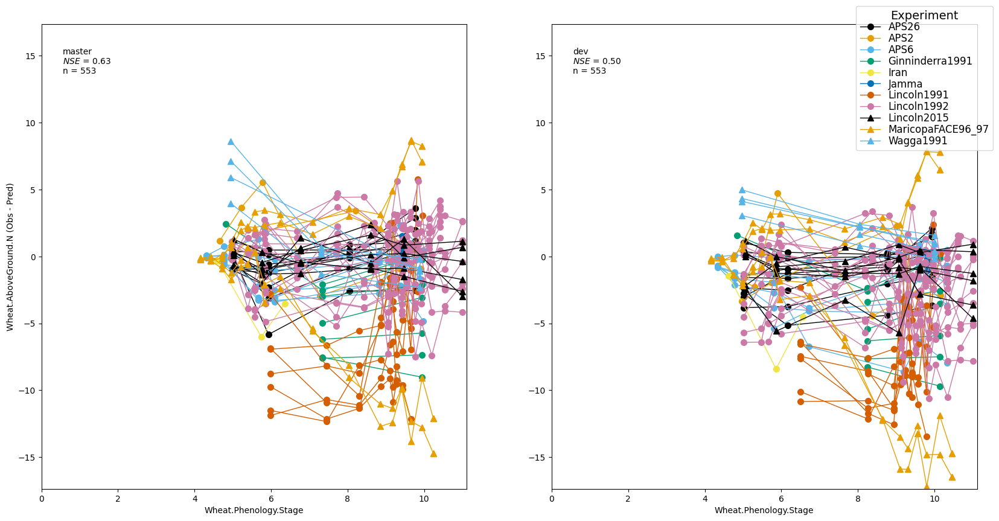

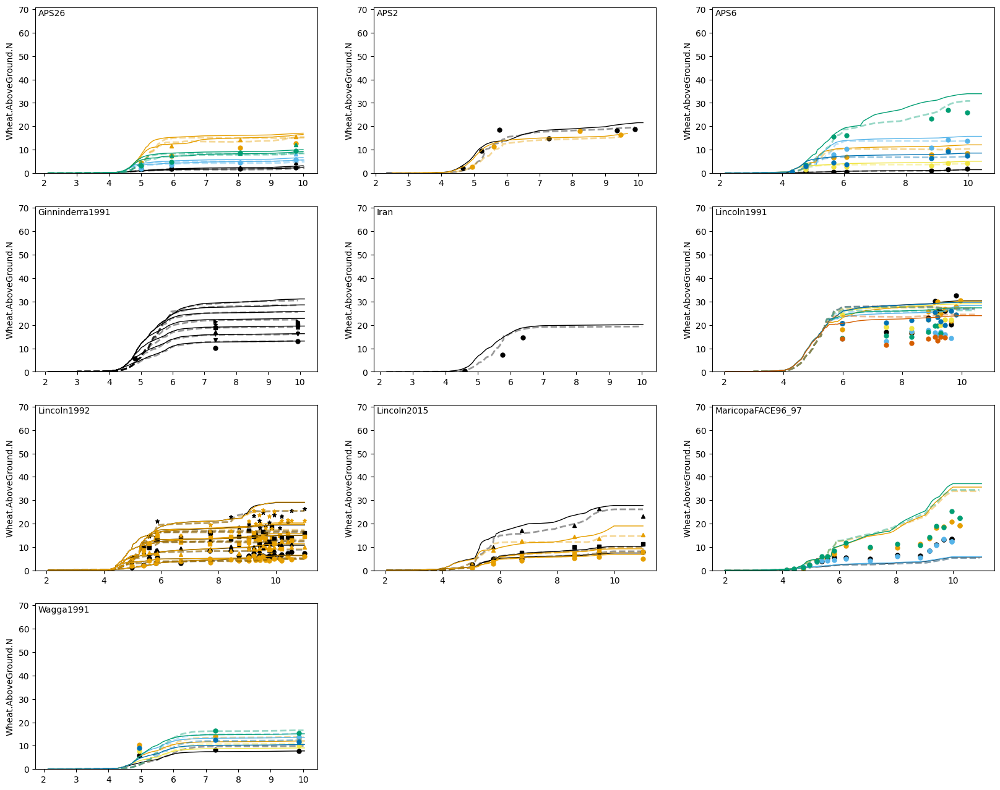

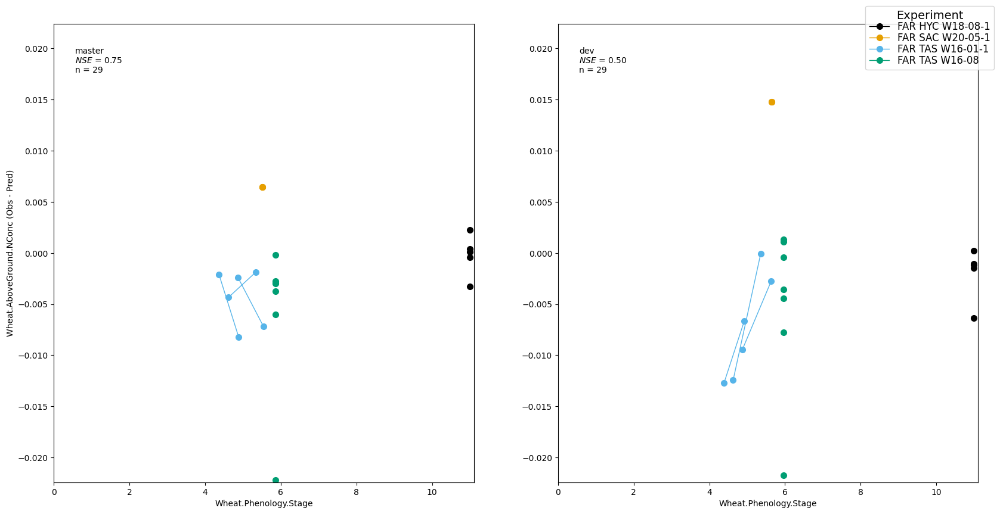

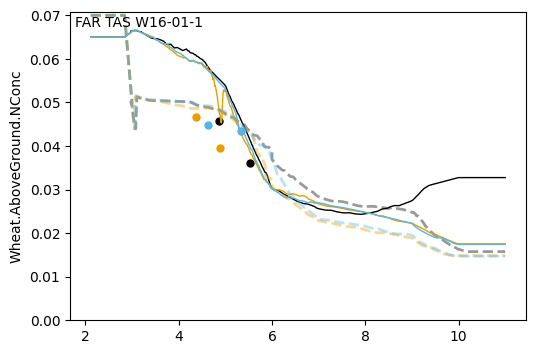

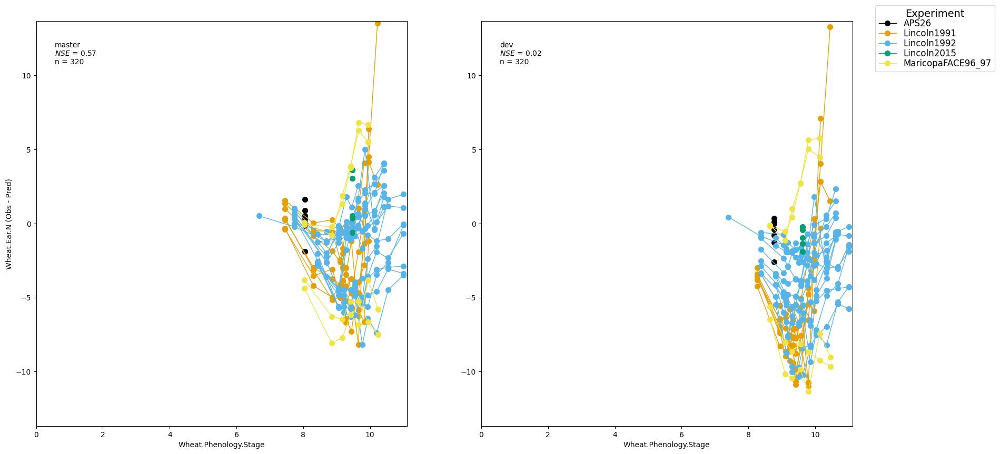

...

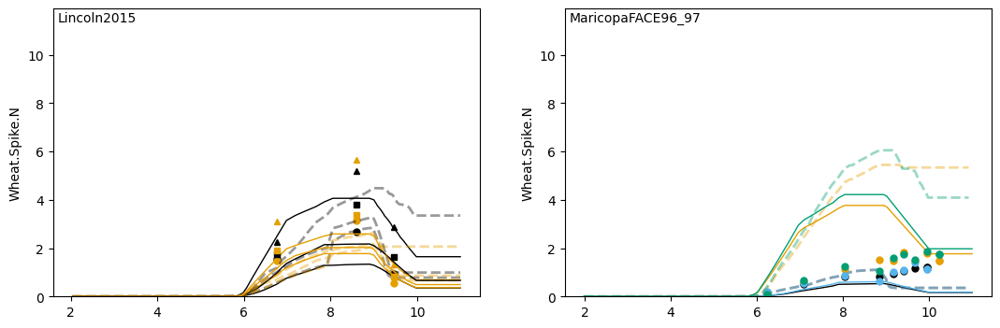

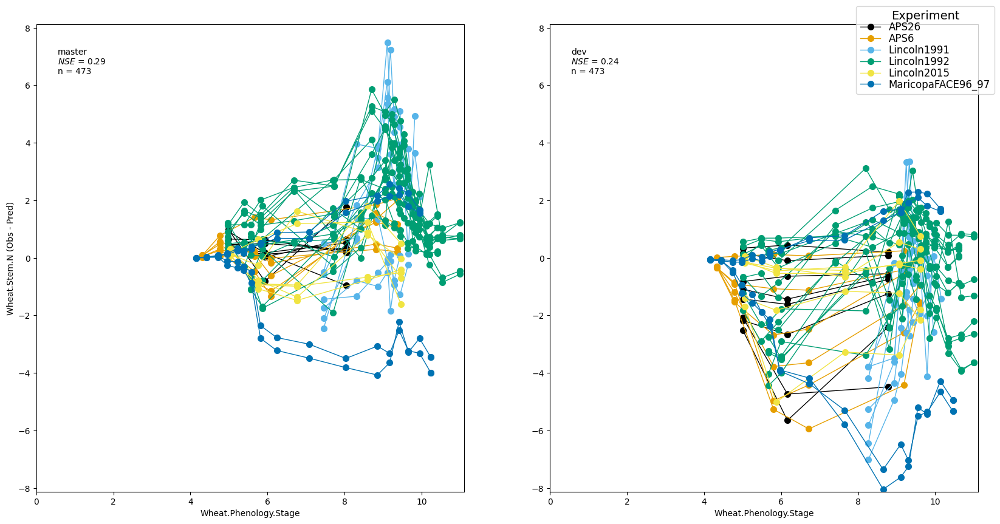

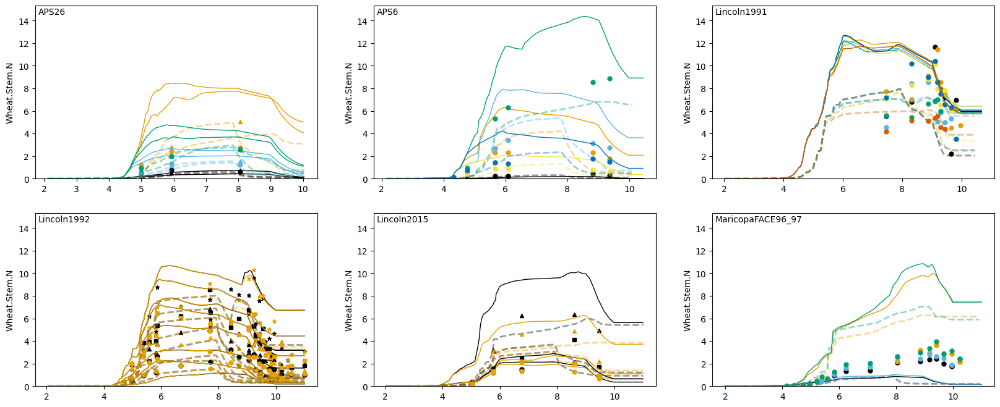

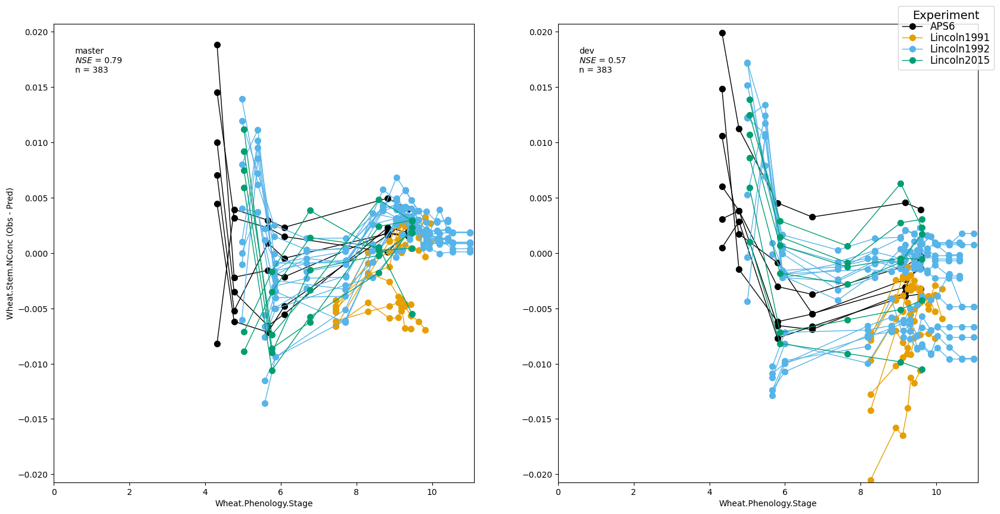

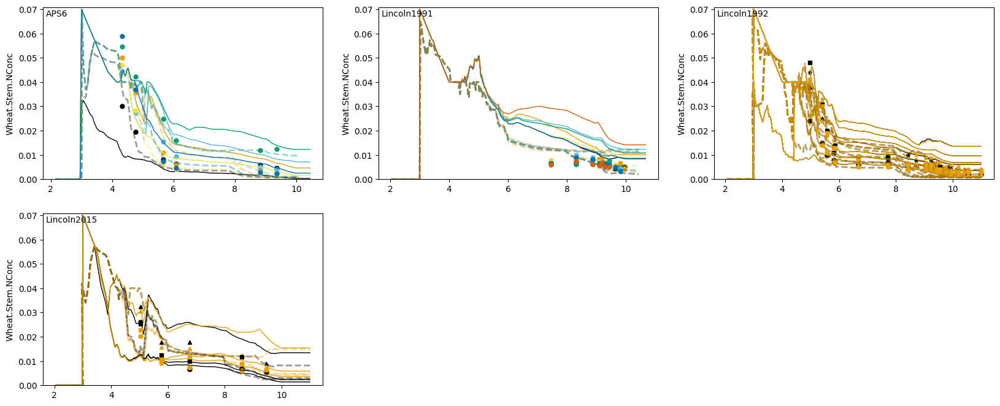

In [23]:
#Graph Nitrogen stuff

NitrogenSet = ['Wheat.AboveGround.N',
             'Wheat.AboveGround.NConc',
             'Wheat.Ear.N',
             'Wheat.Ear.NConc',
             'Wheat.Grain.N',
             'Wheat.Grain.NConc',
             'Wheat.Leaf.Dead.N',
             'Wheat.Leaf.Dead.NConc',
             'Wheat.Leaf.Live.N',
             'Wheat.Leaf.Live.NConc',
             'Wheat.Leaf.N',
             'Wheat.Spike.N',
             'Wheat.Stem.N',
             'Wheat.Stem.NConc']

for var in NitrogenSet:
    try:
        makeGraphs(var)
    except:
        print(var)

In [24]:
Cultivars = list(MasterHarvestObs.loc[:,"Wheat.SowingData.Cultivar"].drop_duplicates())
Cultivars.sort()

In [25]:
DevVars = ['Wheat.Phenology.FinalLeafNumber',
'Wheat.Phenology.FlagLeafDAS',
'Wheat.Phenology.HeadingDAS',
'Wheat.Phenology.FloweringDAS',
'Wheat.Phenology.MaturityDAS']

In [26]:
legpos

{'master': [0.01, 0.79], 'dev': [0.6, 0.29]}

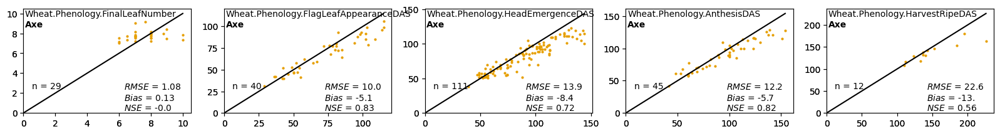

In [27]:
DevGraphs =  plt.figure(figsize=(20,300))
pos=1
for c in Cultivars[4:5]:
    hpos = 1
    for var in DevVars:
        cpos=1
        for p in Pair:
            if p=='dev' and var in list(VariableRenames.keys()):
                var = VariableRenames[var]
            ax = DevGraphs.add_subplot(len(Cultivars),5,pos)
            cFilt = Pair[p]["obs"].loc[:,"Wheat.SowingData.Cultivar"] == c
            obsPred = pd.DataFrame(Pair[p]["obs"].loc[cFilt,var].dropna().copy())
            obsPred.columns = ['obs']
            obsPred.index = obsPred.index.get_level_values(0)
            for s in obsPred.index:
                try:
                    obsPred.loc[s,'pred'] = Pair[p]["pred"].loc[s,var].values[0]
                except:
                    obsPred.loc[s,'pred'] = np.nan
            obsPred.dropna(inplace=True)
            plt.text(0.01,0.89,c,transform=ax.transAxes,horizontalalignment='left', verticalalignment='top',weight='bold')
            if (len(obsPred.obs)>0):
                plt.plot(obsPred.obs,obsPred.pred,'o',ms = 2,color = Colors[cpos])
                plt.text(0.01,0.99,var,transform=ax.transAxes,horizontalalignment='left', verticalalignment='top')
                amax = 1
                if len(obsPred.pred.dropna())>2:
                    RegStats = MUte.MathUtilities.CalcRegressionStats('',obsPred.pred,obsPred.obs)
                    fitR2 = '$RMSE$ = ' + str(RegStats.RMSE)[:4]\
                      + '\n$Bias$ = ' + str(RegStats.ME)[:4] \
                      + '\n$NSE$ = ' + str(RegStats.NSE)[:4]\
                      #+ '\n$R^2$ = ' + str(RegStats.R2)[:4]
                    plt.text(legpos[p][0],legpos[p][1],fitR2,transform=ax.transAxes,horizontalalignment='left', verticalalignment='top')
                    n = len(obsPred.obs)
                    plt.text(0.05,.3,'n = '+ str(n),transform=ax.transAxes,horizontalalignment='left', verticalalignment='top')
                    if len(obsPred.pred.dropna())>0:
                        axmax = max(obsPred.obs.max(),obsPred.pred.max())
                plt.ylim(0,axmax*1.05)
                plt.xlim(0,axmax*1.05)
                plt.plot([0,axmax],[0,axmax],'-',color='k')
            cpos+=1
        pos+=1